In [1]:
!pwd

/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation


In [2]:
import tensorflow as tf
import numpy as np
import cv2 
import matplotlib.pyplot as plt

import glob
import matplotlib.pylab as plt
import pydicom as dicom
import nibabel as nib

import os
import pathlib
import time
import datetime

from matplotlib import pyplot as plt
from IPython import display

2024-11-20 14:21:18.321962: E external/local_xla/xla/stream_executor/cuda/cuda_dnn.cc:9261] Unable to register cuDNN factory: Attempting to register factory for plugin cuDNN when one has already been registered
2024-11-20 14:21:18.321994: E external/local_xla/xla/stream_executor/cuda/cuda_fft.cc:607] Unable to register cuFFT factory: Attempting to register factory for plugin cuFFT when one has already been registered
2024-11-20 14:21:18.322828: E external/local_xla/xla/stream_executor/cuda/cuda_blas.cc:1515] Unable to register cuBLAS factory: Attempting to register factory for plugin cuBLAS when one has already been registered
2024-11-20 14:21:18.327684: I tensorflow/core/platform/cpu_feature_guard.cc:182] This TensorFlow binary is optimized to use available CPU instructions in performance-critical operations.
To enable the following instructions: AVX2 FMA, in other operations, rebuild TensorFlow with the appropriate compiler flags.
2024-11-20 14:21:18.850425: W tensorflow/compiler/tf2

In [3]:
#import cgan_model_four as cgan_model
#from model import Generator, Discriminator
import model
import data_loader_two

In [4]:
IMG_WIDTH = 256
IMG_HEIGHT = 256

IVIM_IMG_WIDTH = 256
IVIM_IMG_HEIGHT = 256

In [5]:
generator = model.Generator()
discriminator = model.Discriminator()

generator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)
discriminator_optimizer = tf.keras.optimizers.Adam(2e-4, beta_1=0.5)

2024-11-20 14:21:22.739610: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-11-20 14:21:22.739925: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-L355
2024-11-20 14:21:22.772180: I external/local_xla/xla/stream_executor/cuda/cuda_executor.cc:901] successful NUMA node read from SysFS had negative value (-1), but there must be at least one NUMA node, so returning NUMA node zero. See more at https://github.com/torvalds/linux/blob/v6.0/Documentation/ABI/testing/sysfs-bus-pci#L344-

In [265]:
"""
checkpoint_dir = './training_checkpoints'
checkpoint_prefix = os.path.join(checkpoint_dir, "ckpt")
checkpoint = tf.train.Checkpoint(generator_optimizer=generator_optimizer,
                                 discriminator_optimizer=discriminator_optimizer,
                                 generator=generator,
                                 discriminator=discriminator)


# restore specific checkpoint
this_checkpoint = '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/training_checkpoints/second_finetune_weights/checkpoint_epoch_60.h5'
checkpoint.restore(this_checkpoint)
"""

weight_path = '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/training_checkpoints/second_finetune_weights/checkpoint_epoch_60.h5'
generator.load_weights(weight_path)

In [266]:
def plot(scan, roi, bval):
    #mask = cv2.rotate(mask, cv2.ROTATE_90_COUNTERCLOCKWISE)
    fig = plt.figure(figsize=(20, 20))
    fig.add_subplot(1, 3, 1)
    plt.axis('off')
    plt.imshow(scan, cmap='gray')
    plt.title('TRACE_W; b_val='+str(bval))


    fig.add_subplot(1, 3, 2)
    plt.axis('off')
    plt.imshow(roi, cmap='gray')
    plt.title('Predicted ROI')

    fig.add_subplot(1, 3, 3) 
    plt.axis('off')
    plt.imshow(scan, cmap='gray', alpha=1, interpolation='none') 
    plt.imshow(roi, 'jet', alpha=0.6, interpolation='none')
    plt.title('Overlayed ROI')
    
    
    plt.show()

In [267]:
def precision_score_(groundtruth_mask, pred_mask):
    intersect = np.sum(pred_mask*groundtruth_mask)
    total_pixel_pred = np.sum(pred_mask)
    precision = np.mean(intersect/total_pixel_pred)
    return round(precision, 3)

def recall_score_(groundtruth_mask, pred_mask):
    intersect = np.sum(pred_mask*groundtruth_mask)
    total_pixel_truth = np.sum(groundtruth_mask)
    recall = np.mean(intersect/total_pixel_truth)
    return round(recall, 3)

def accuracy(groundtruth_mask, pred_mask):
    intersect = np.sum(pred_mask*groundtruth_mask)
    union = np.sum(pred_mask) + np.sum(groundtruth_mask) - intersect
    xor = np.sum(groundtruth_mask==pred_mask)
    acc = np.mean(xor/(union + xor - intersect))
    return round(acc, 3)

def dice_coef(groundtruth_mask, pred_mask):
    intersect = np.sum(pred_mask*groundtruth_mask)
    total_sum = np.sum(pred_mask) + np.sum(groundtruth_mask)
    dice = np.mean(2*intersect/total_sum)
    return round(dice, 3) #round up to 3 decimal places

def iou(groundtruth_mask, pred_mask):
    intersect = np.sum(pred_mask*groundtruth_mask)
    union = np.sum(pred_mask) + np.sum(groundtruth_mask) - intersect
    iou = np.mean(intersect/union)
    return round(iou, 3)

def unsharp_mask(image, kernel_size=(5, 5), sigma=1.0, amount=1.0, threshold=0):
    """Return a sharpened version of the image, using an unsharp mask."""
    blurred = cv2.GaussianBlur(image, kernel_size, sigma)
    sharpened = float(amount + 1) * image - float(amount) * blurred
    sharpened = np.maximum(sharpened, np.zeros(sharpened.shape))
    sharpened = np.minimum(sharpened, 255 * np.ones(sharpened.shape))
    sharpened = sharpened.round().astype(np.uint8)
    if threshold > 0:
        low_contrast_mask = np.absolute(image - blurred) < threshold
        np.copyto(sharpened, image, where=low_contrast_mask)
    return sharpened

In [268]:
def increase_class_id(img):
    rows, coloumns = img.shape
    for row in range(rows):
        for coloumn in range(coloumns):
            if img[row,coloumn] > 0:
                img[row,coloumn] = img[row,coloumn] + 5
    return img

def hot_encoded_to_single_channel(mask):
  """
  Converts a six-channel hot-encoded segmentation mask to a single-channel image.

  Args:
      mask: A numpy array representing the six-channel hot-encoded segmentation mask.

  Returns:
      A numpy array with the same shape as the first two dimensions of the input mask,
      representing the dominant class for each pixel (0-indexed).

  Raises:
      ValueError: If the input mask does not have six channels.
  """

  # Check if the input has six channels (expected for hot-encoded mask)
  if mask.shape[-1] != 6:
    raise ValueError("Expected six-channel hot-encoded mask.")

  # Get the class with the highest probability for each pixel (argmax)
  dominant_class = np.argmax(mask, axis=-1)

  return dominant_class

In [269]:
def predict_and_plot_export_npy(folder_path):
    scans = glob.glob(folder_path)
    scans.sort()
    #normalize = tf.keras.layers.Normalization(axis=None)
    for scan in scans:
        
        data = dicom.dcmread(scan)
        scan_image = data.pixel_array
        bval = data[0x0019, 0x100c].value
        scan_image_left, scan_image_right = data_loader_two.split_image(scan_image)
        
        scan_image_left = cv2.resize(scan_image_left, (IMG_WIDTH, IMG_HEIGHT), interpolation = cv2.INTER_LINEAR)
        scan_image_right = cv2.resize(scan_image_right, (IMG_WIDTH, IMG_HEIGHT), interpolation = cv2.INTER_LINEAR)
    
        scan_image_left = np.reshape(scan_image_left, (1, IMG_WIDTH, IMG_HEIGHT))
        scan_image_right = np.reshape(scan_image_right, (1, IMG_WIDTH, IMG_HEIGHT))

        #checkpoint.restore('./training_checkpoints/ckpt-47')


        left_predicted_roi = generator(scan_image_left)
        right_predicted_roi = generator(scan_image_right)
    
        left_predicted_roi = np.reshape(left_predicted_roi, (IMG_WIDTH, IMG_HEIGHT,6))
        right_predicted_roi = np.reshape(right_predicted_roi, (IMG_WIDTH, IMG_HEIGHT,6))


        left_predicted_merged_roi = hot_encoded_to_single_channel(left_predicted_roi)
        right_predicted_merged_roi = hot_encoded_to_single_channel(right_predicted_roi)
        right_predicted_merged_roi = increase_class_id(right_predicted_merged_roi)

        left_predicted_merged_roi = cv2.resize(left_predicted_merged_roi, (96, 126), interpolation = cv2.INTER_NEAREST)
        right_predicted_merged_roi = cv2.resize(right_predicted_merged_roi, (96, 126), interpolation = cv2.INTER_NEAREST)

        predicted_roi = np.concatenate((left_predicted_merged_roi, right_predicted_merged_roi), axis=1)
        #plot(scan_image_left, left_predicted_roi)
        #plot(scan_image_right, right_predicted_roi)
        
        zero = np.zeros((256,256,6))
        results_dir = '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/'+folder_path
        results_name = str(bval)+'.npy'

        if not os.path.exists(results_dir):
            os.makedirs(results_dir)
            
        file_path = os.path.join(results_dir, results_name)
        
        left_predicted_roi = np.concatenate((left_predicted_roi, zero), axis=1)
        right_predicted_roi = np.concatenate((zero, right_predicted_roi), axis=1)
        ten_rois = np.concatenate((left_predicted_roi[:, :, 1:], right_predicted_roi[:, :, 1:]), axis=-1)
        np.save(file_path, ten_rois)
        #print(ten_rois.shape)
        np.save(file_path+'roi_roi.npy', predicted_roi)
        #print(predicted_roi.shape)

        plot(scan_image, predicted_roi, bval)

In [270]:
data_path = '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/'
test_data_samples = ['PMRI013/', 'PMRI014/', 'PMRI015/']

In [271]:
roi_path = '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/11_SegMask/'
test_rois = ['PMRI013_SLICE_1ST_IVIM_ROI/', 'PMRI013_SLICE_2ND_IVIM_ROI/', 'PMRI014_SLICE_1ST_IVIM_ROI/', 'PMRI014_SLICE_2N_IVIM_ROI/', 
             'PMRI015_SLICE_1ST_IVIM_ROI/', 'PMRI015_SLICE_2ND_IVIM_ROI/']

## PMRI 13

In [272]:
scanfolders = glob.glob(data_path + test_data_samples[0] + '*TRACEW*')
scanfolders

['/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/PMRI013/IVIM_BASELINE_TRACEW_0014',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/PMRI013/IVIM_HI-Q_TRACEW_0016',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/PMRI013/IVIM_BASELINE_TRACEW_0008',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/PMRI013/IVIM_HI-Q_TRACEW_0010']

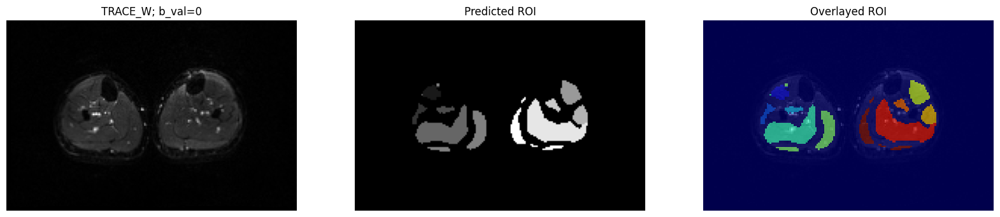

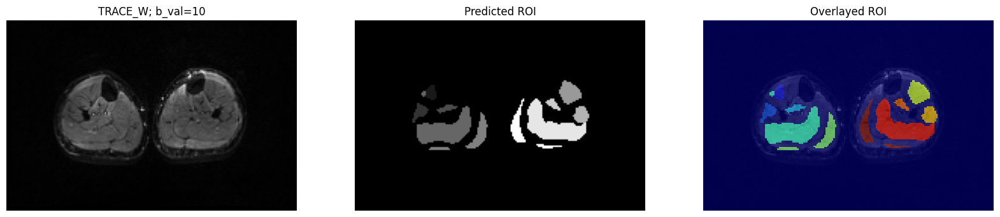

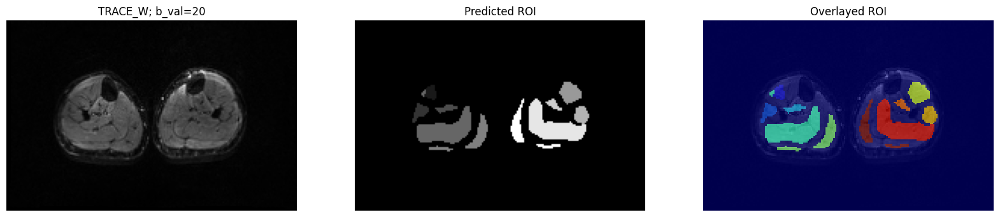

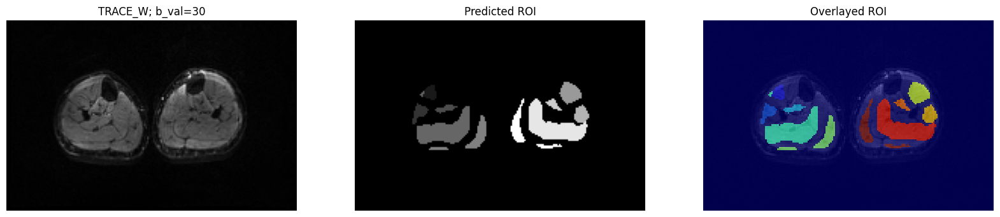

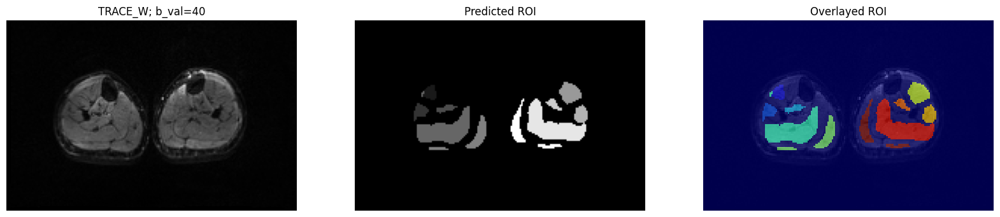

...

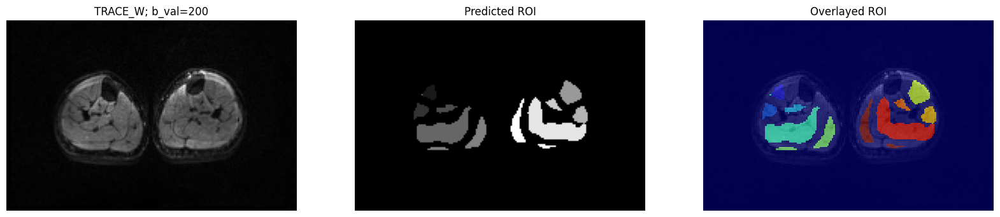

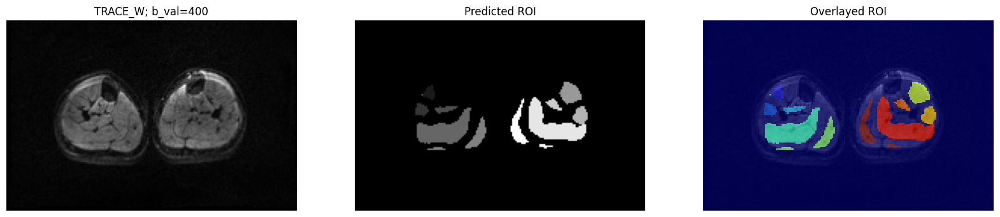

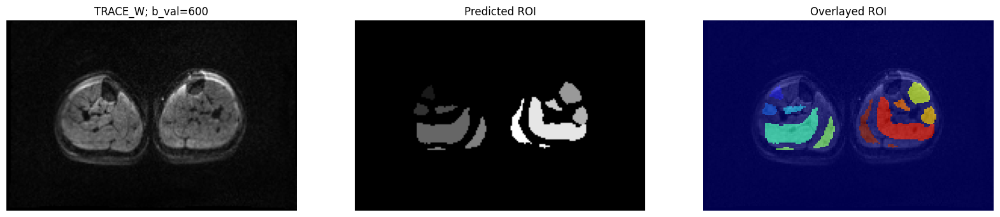

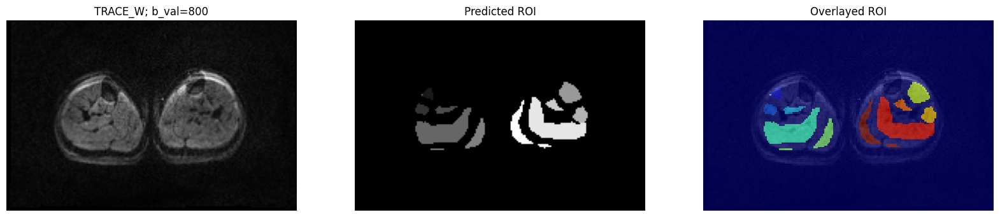

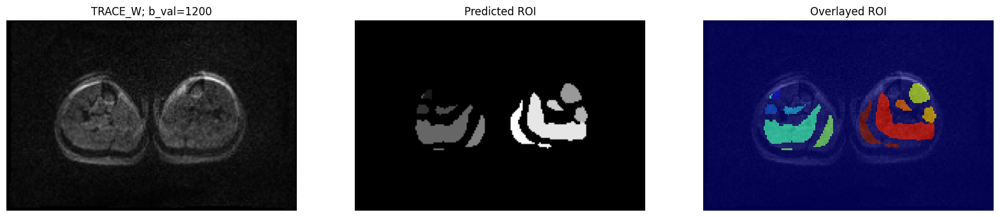

In [273]:
predict_and_plot_export_npy(scanfolders[0]+'/*')

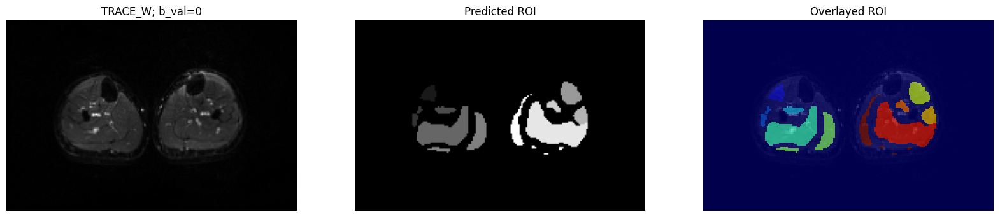

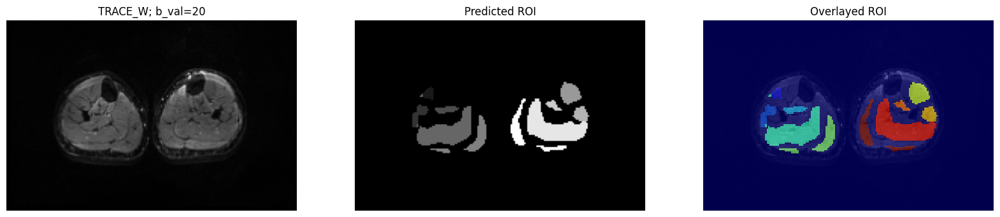

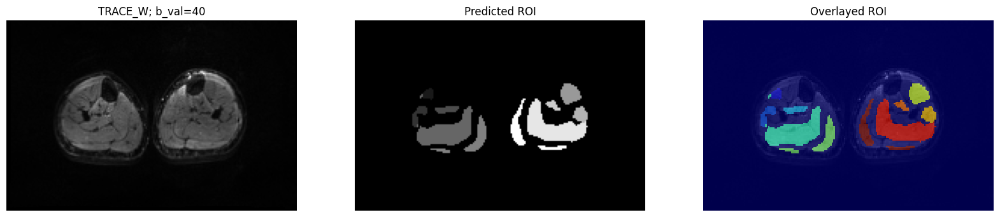

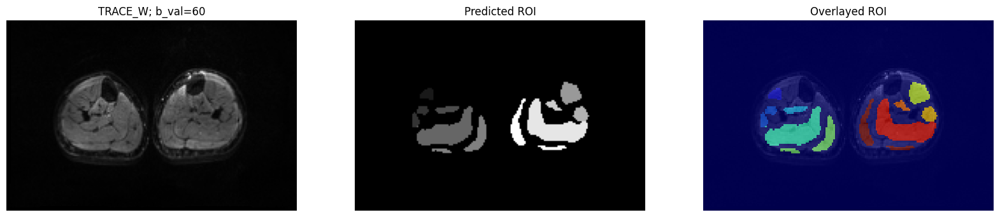

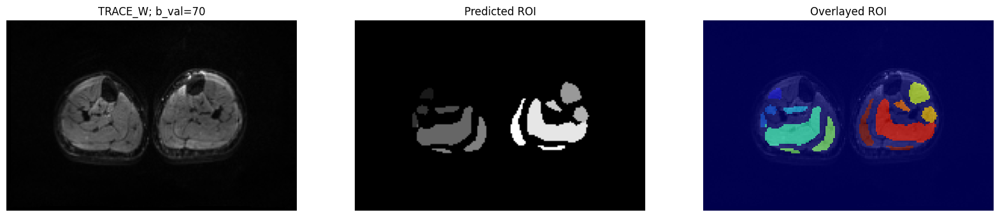

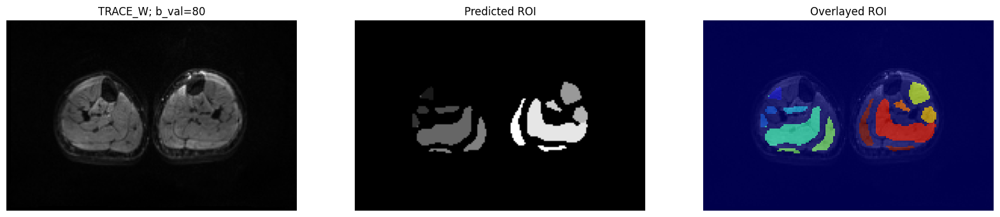

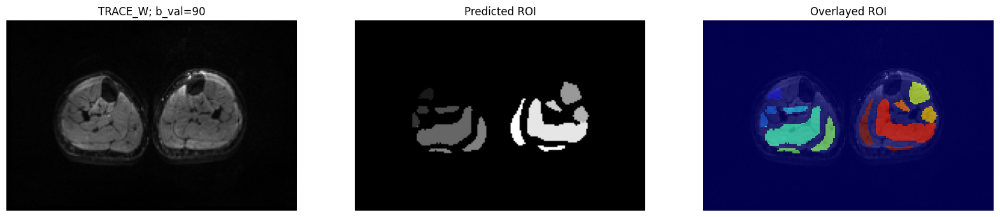

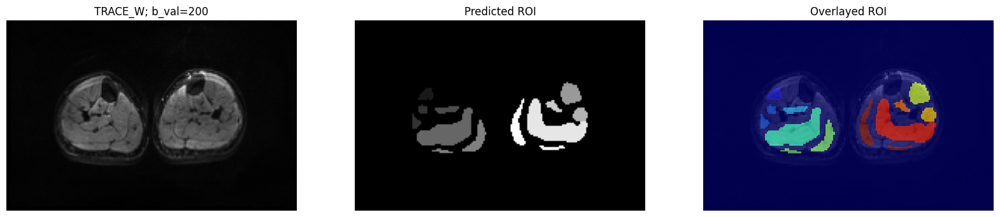

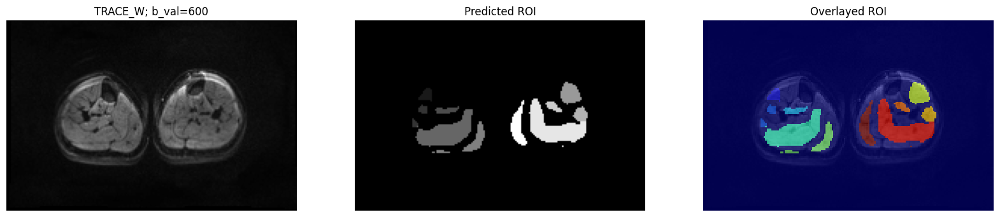

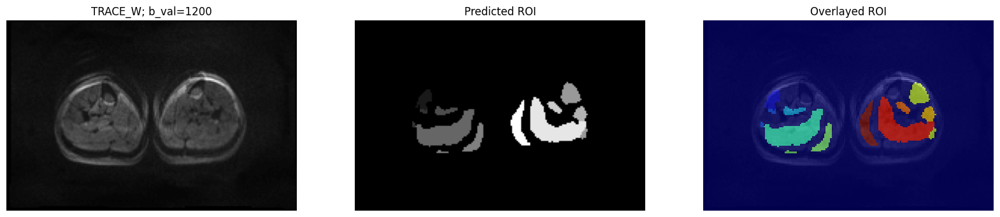

In [274]:
predict_and_plot_export_npy(scanfolders[1]+'/*')

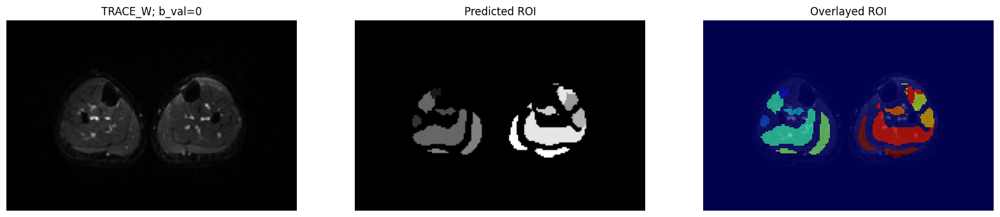

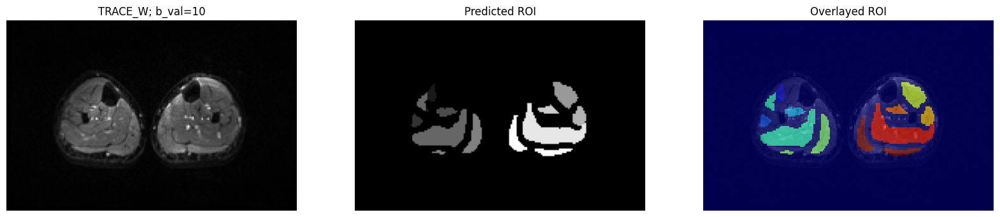

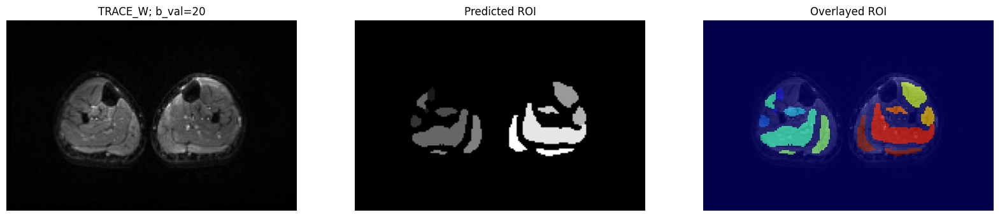

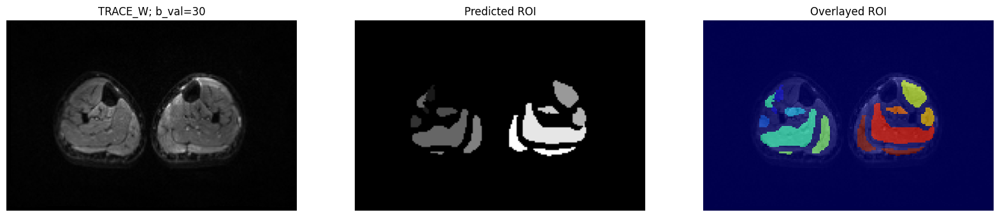

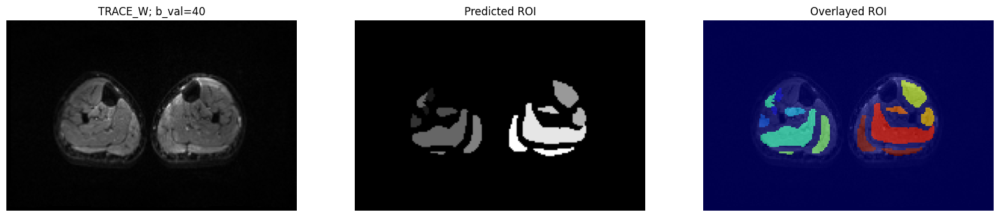

...

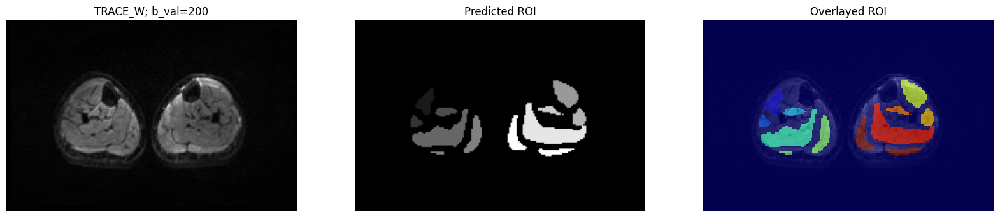

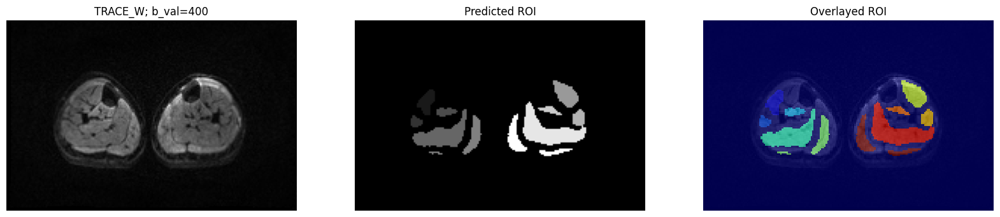

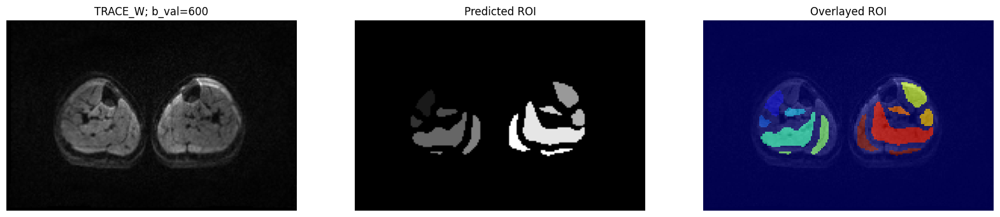

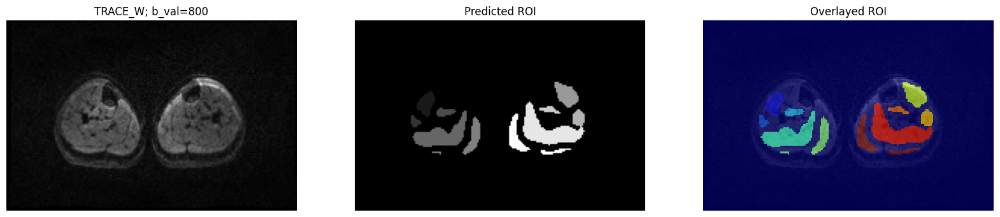

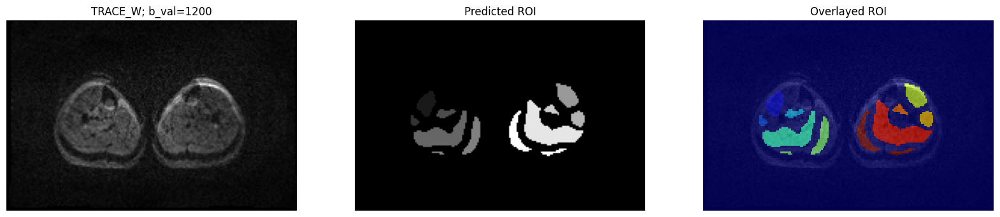

In [275]:
predict_and_plot_export_npy(scanfolders[2]+'/*')

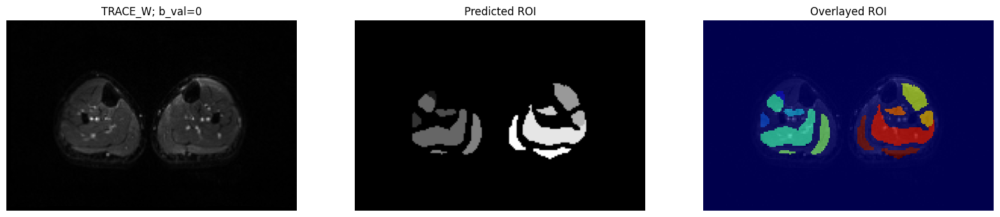

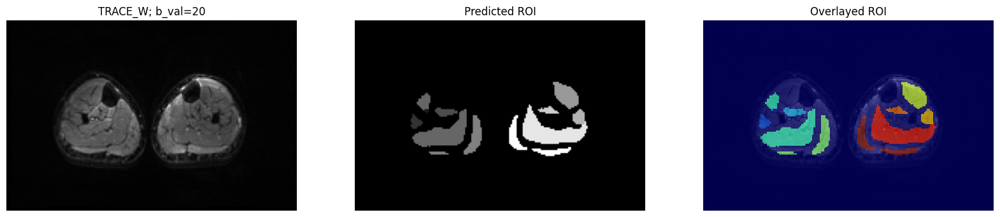

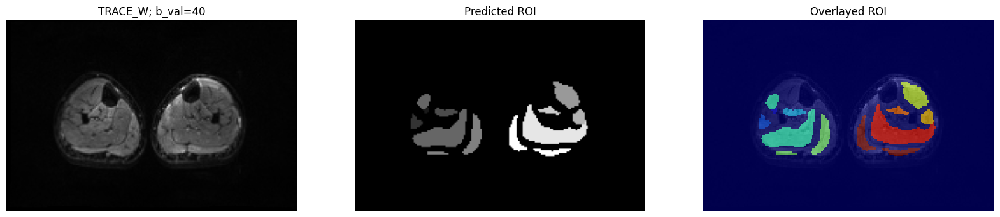

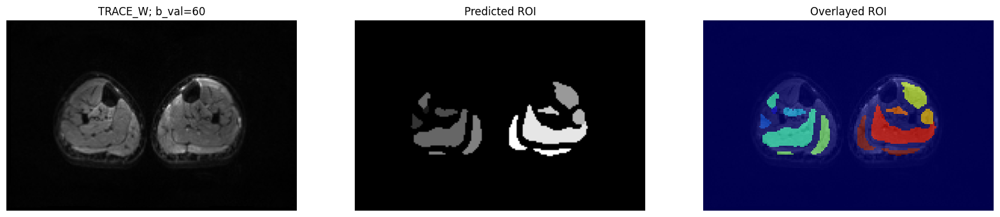

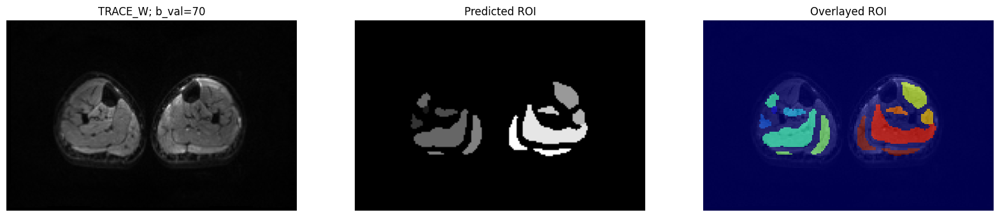

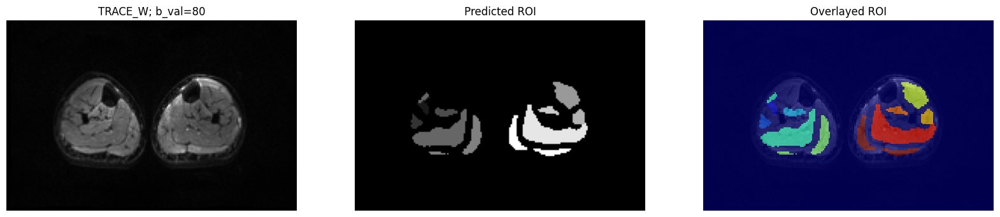

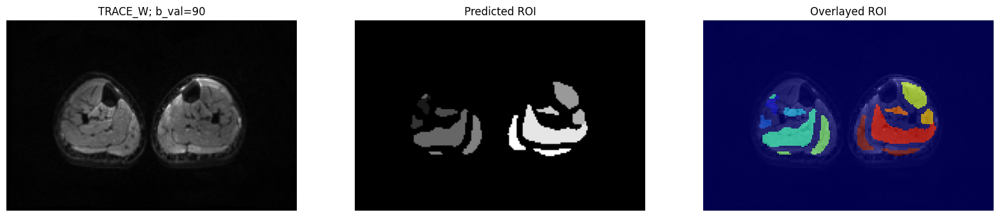

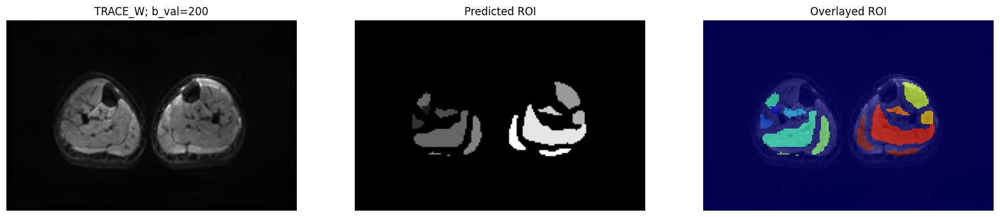

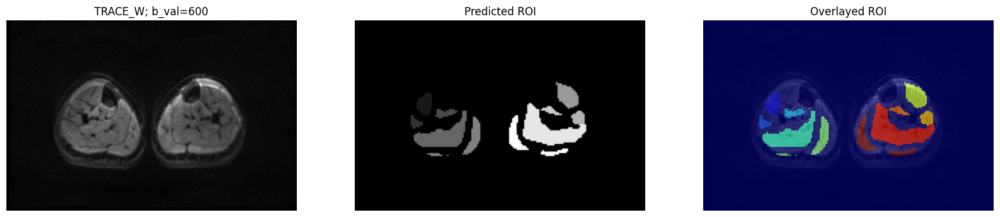

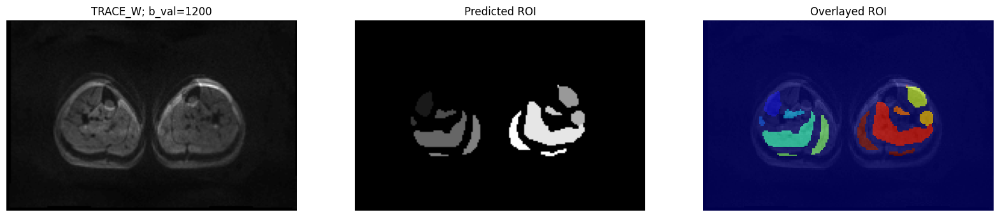

In [276]:
predict_and_plot_export_npy(scanfolders[3]+'/*')

## PMRI 14

In [277]:
scanfolders = glob.glob(data_path + test_data_samples[1] + '*TRACEW*')
scanfolders

['/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/PMRI014/IVIM_BASELINE_TRACEW_0007',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/PMRI014/IVIM_BASELINE_TRACEW_0013',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/PMRI014/IVIM_HI-Q_TRACEW_0009',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/PMRI014/IVIM_HI-Q_TRACEW_0015']

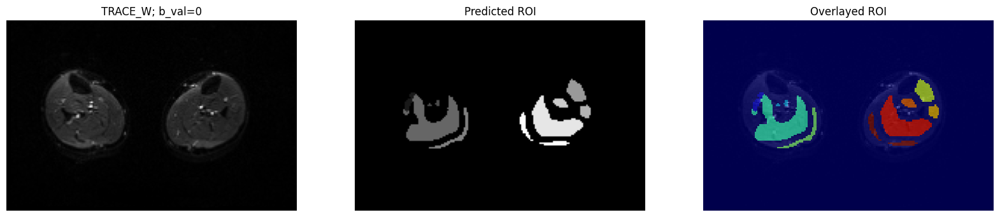

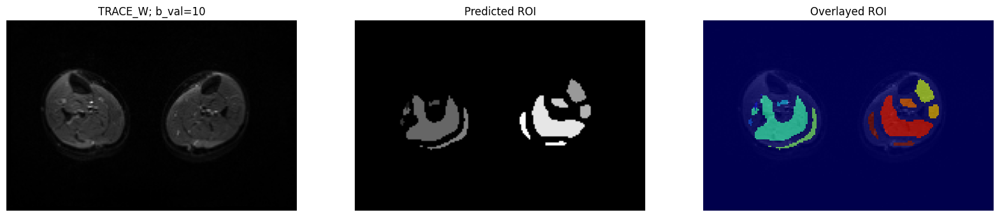

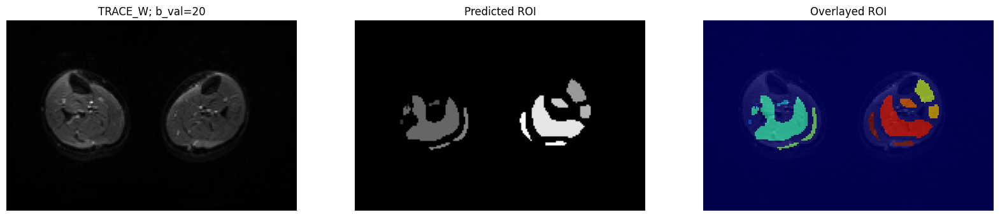

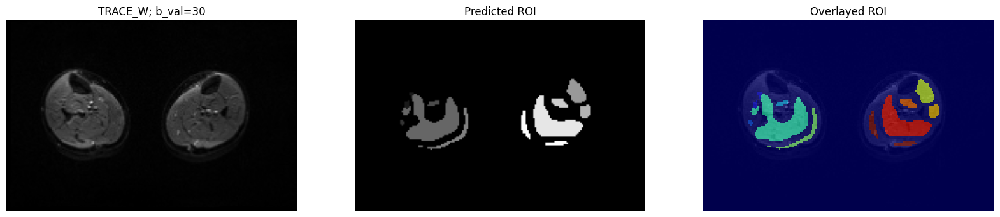

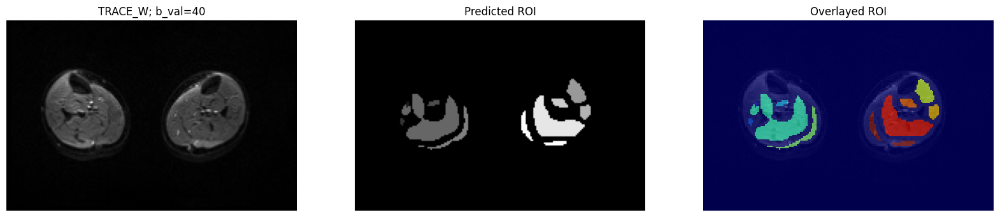

...

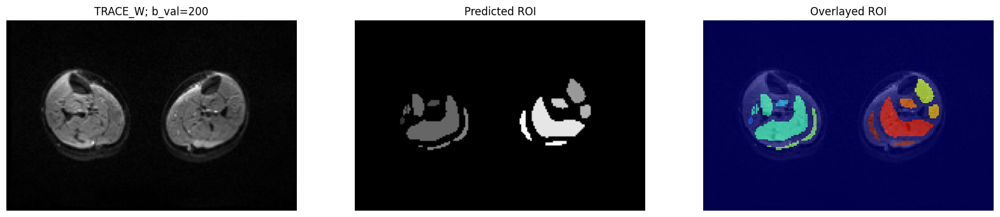

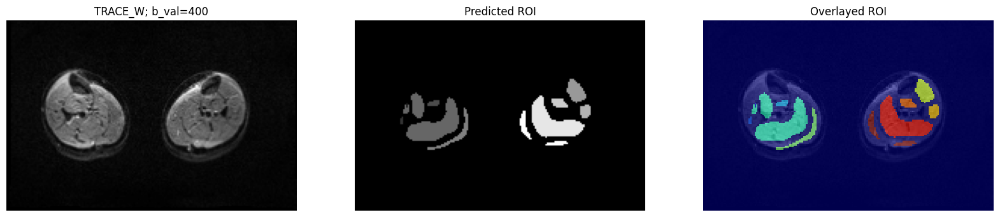

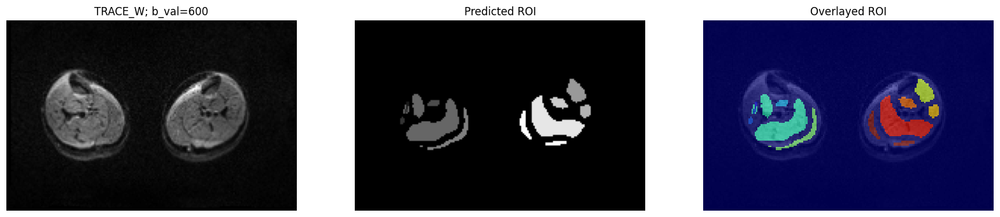

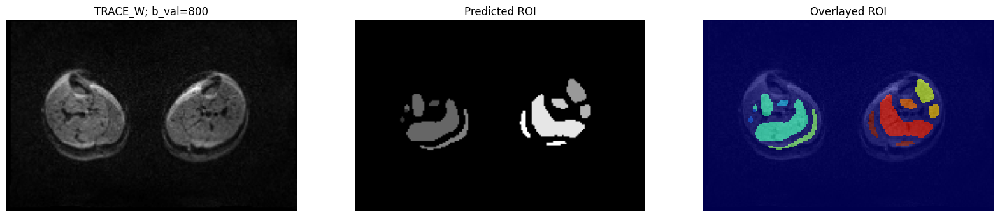

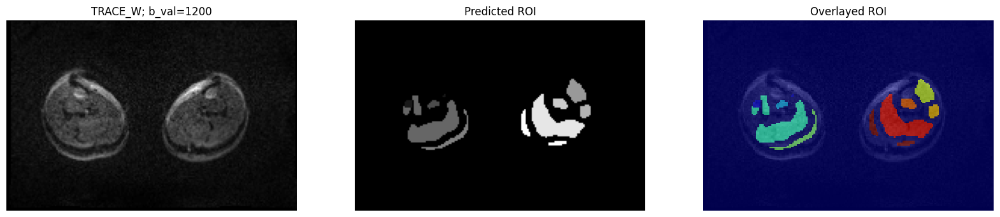

In [278]:
predict_and_plot_export_npy(scanfolders[0]+'/*')

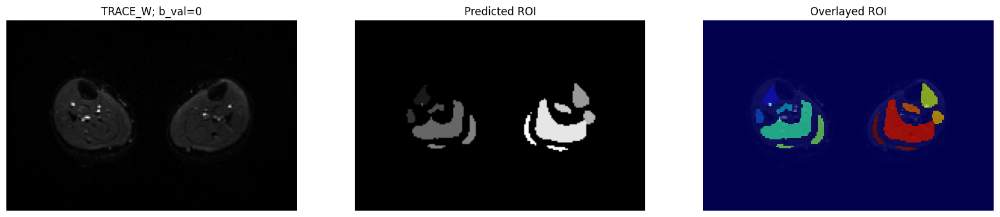

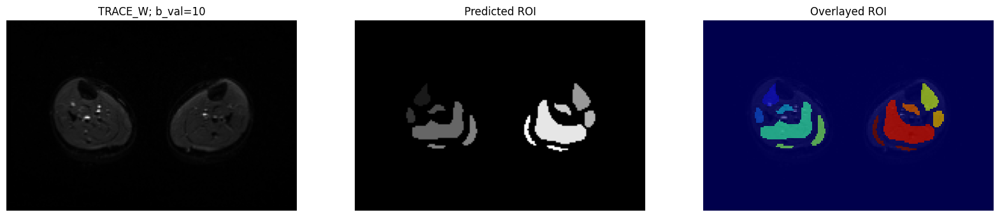

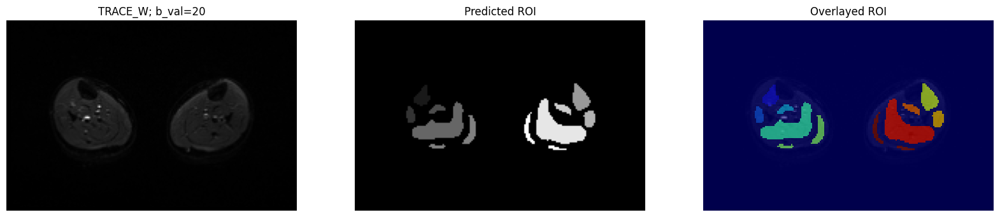

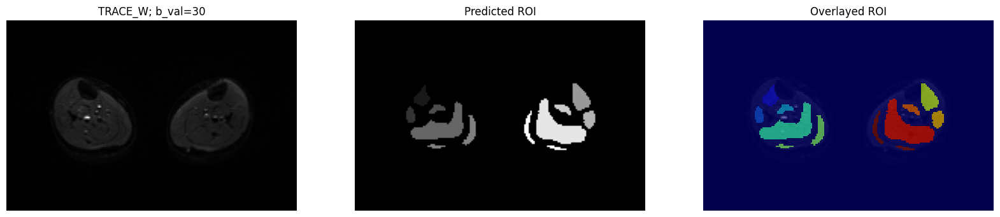

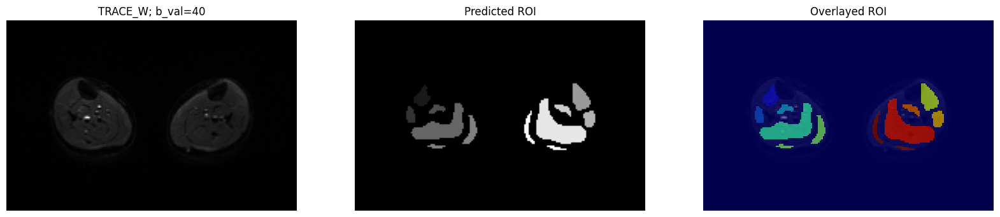

...

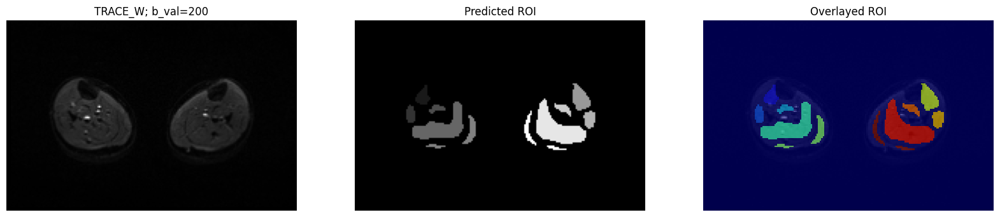

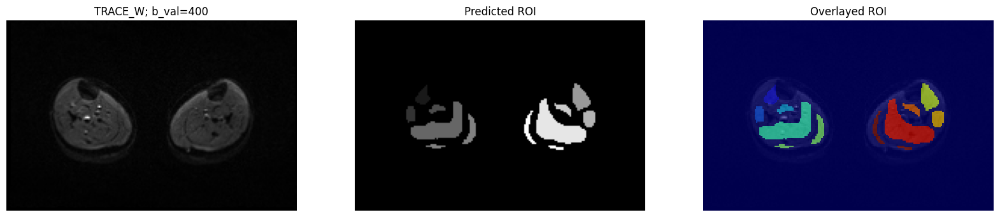

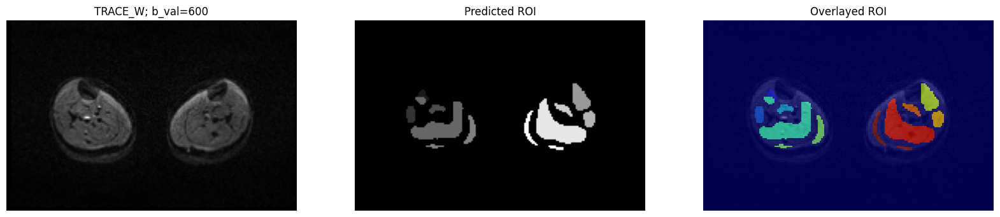

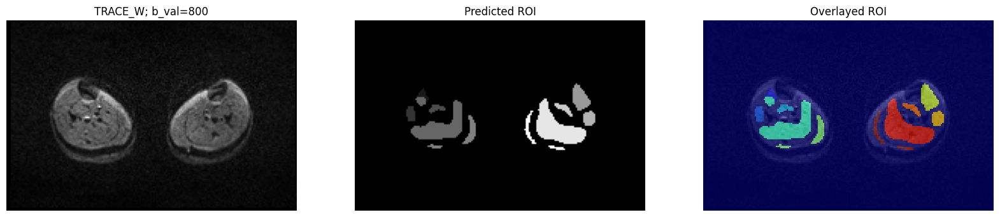

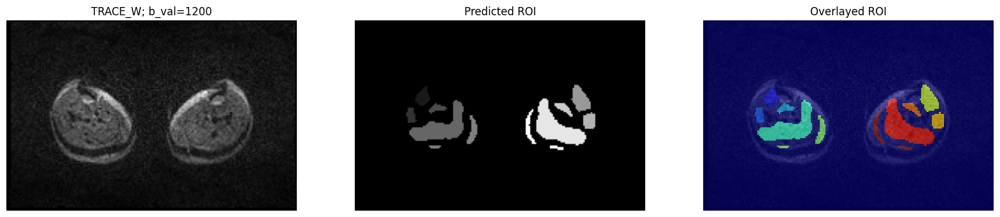

In [279]:
predict_and_plot_export_npy(scanfolders[1]+'/*')

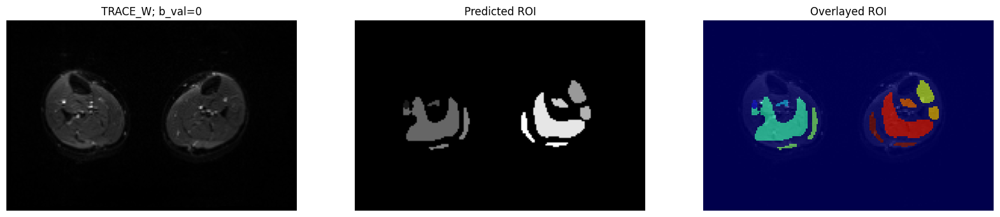

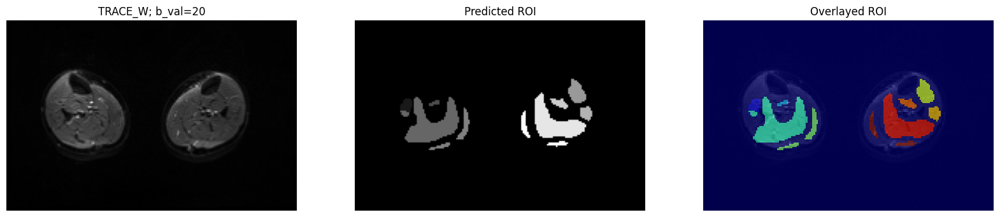

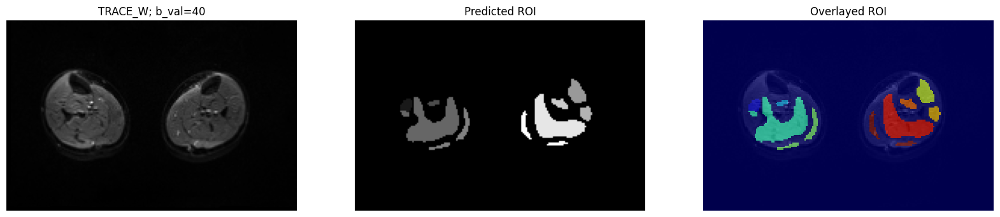

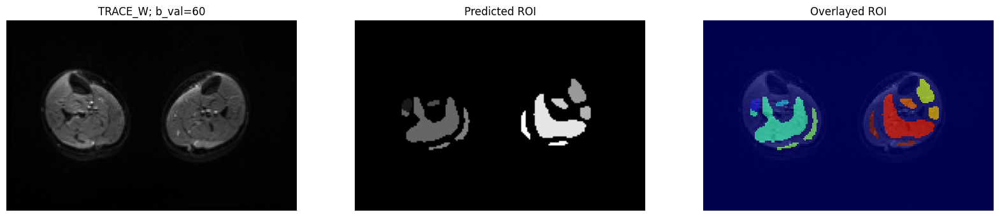

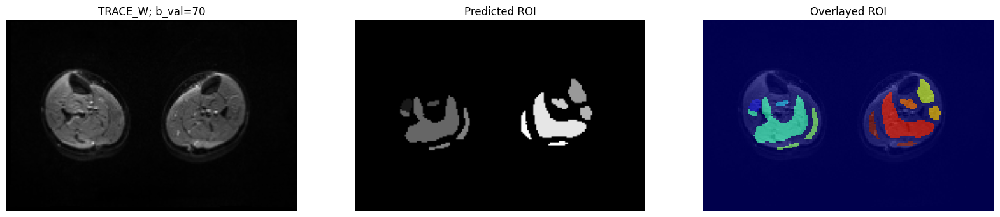

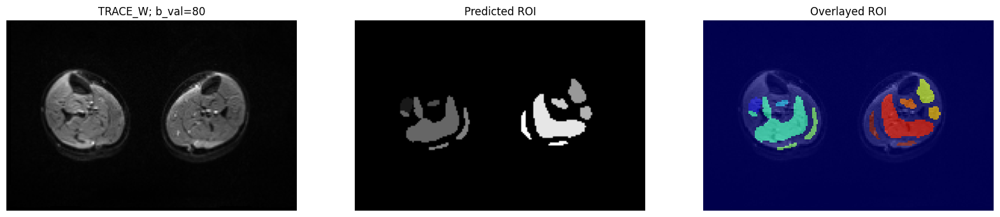

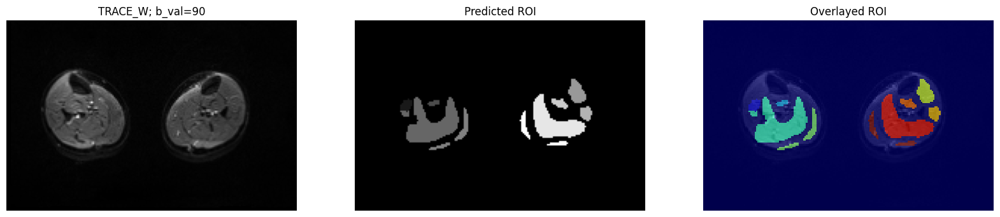

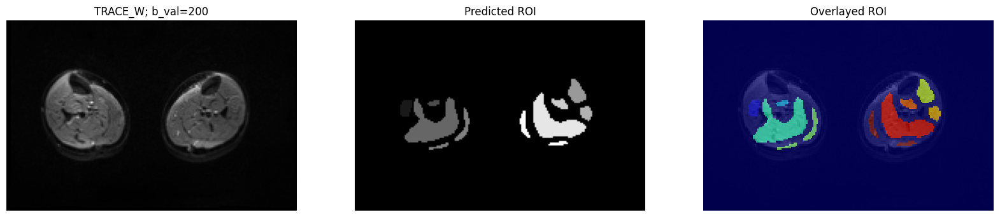

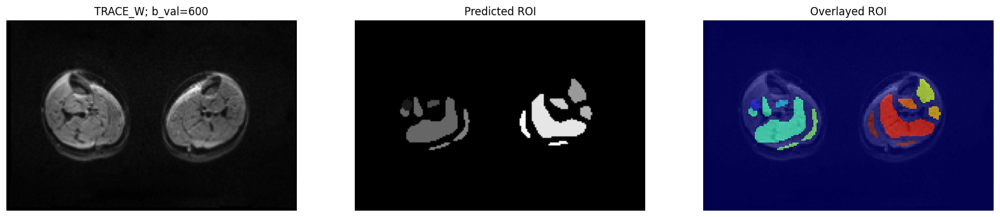

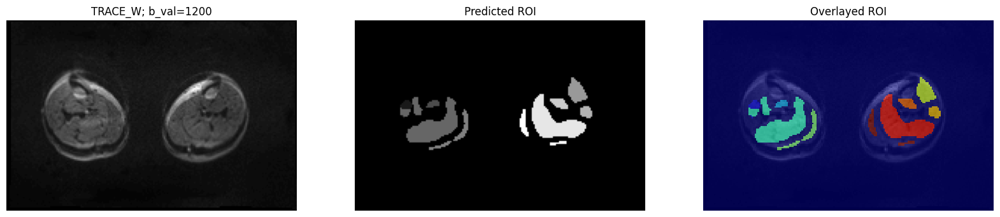

In [280]:
predict_and_plot_export_npy(scanfolders[2]+'/*')

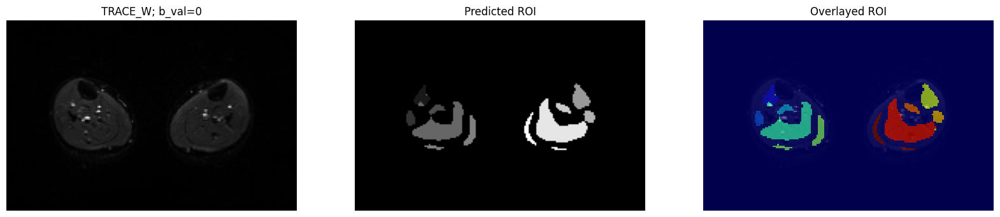

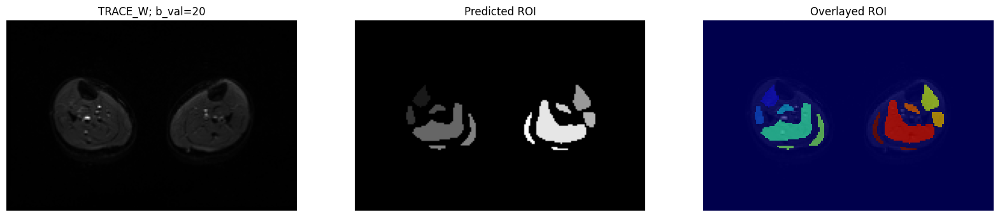

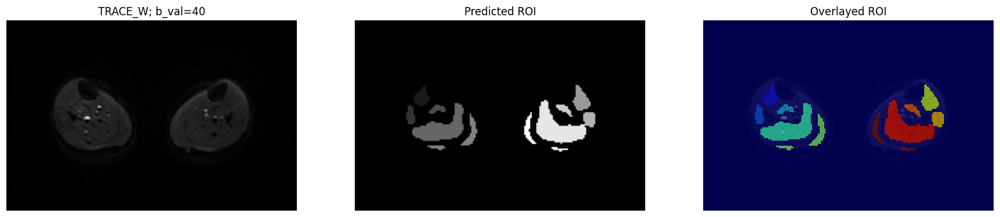

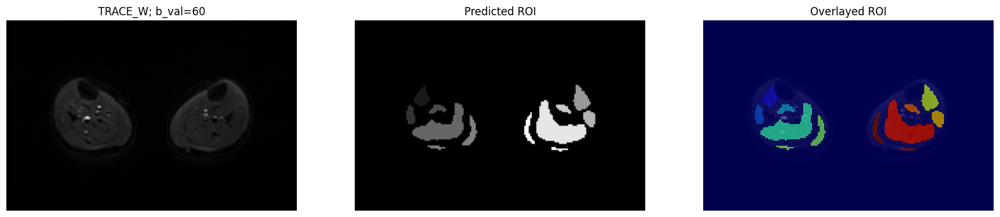

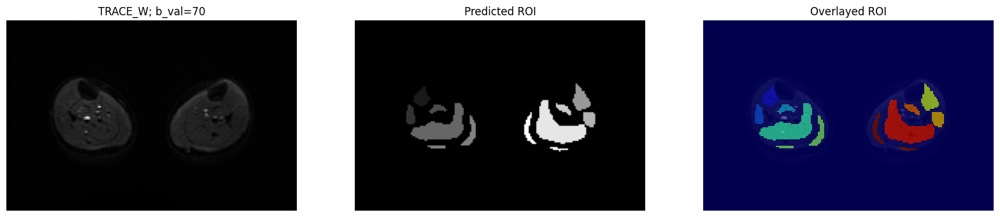

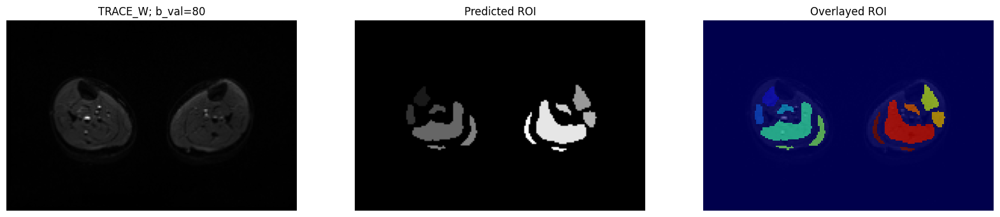

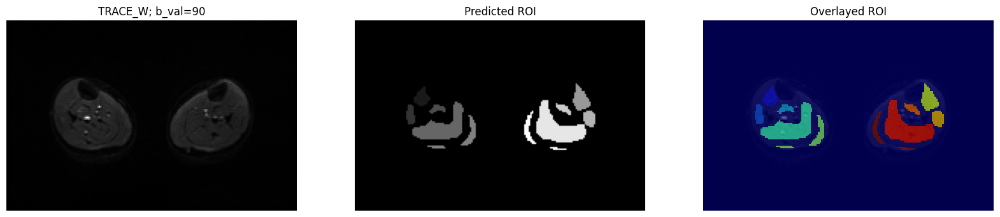

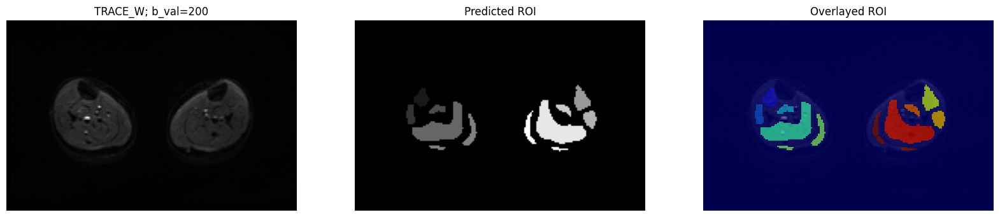

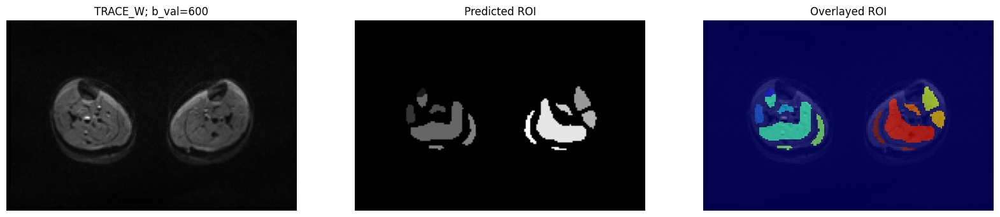

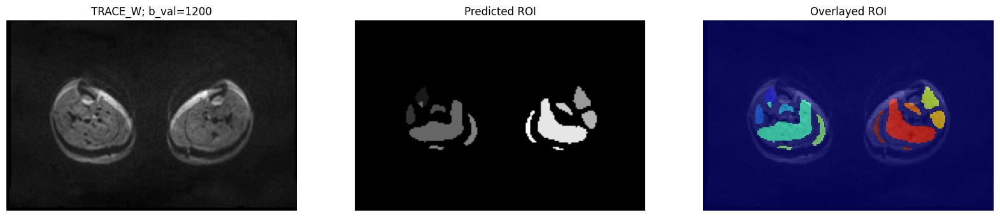

In [281]:
predict_and_plot_export_npy(scanfolders[3]+'/*')

## PMRI 15

In [282]:
scanfolders = glob.glob(data_path + test_data_samples[2] + '*TRACEW*')
scanfolders

['/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/PMRI015/IVIM_BASELINE_TRACEW_0007',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/PMRI015/IVIM_BASELINE_TRACEW_0013',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/PMRI015/IVIM_HI-Q_TRACEW_0009',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/PMRI_Scans/DCM/PMRI015/IVIM_HI-Q_TRACEW_0015']

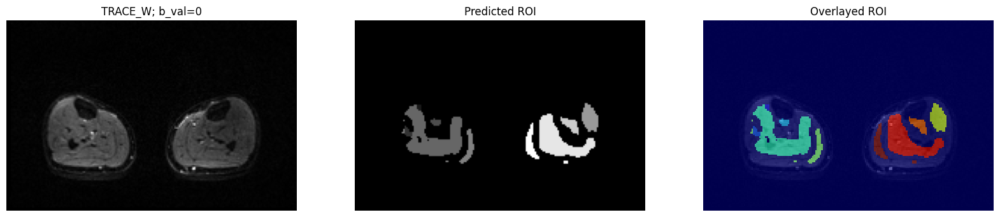

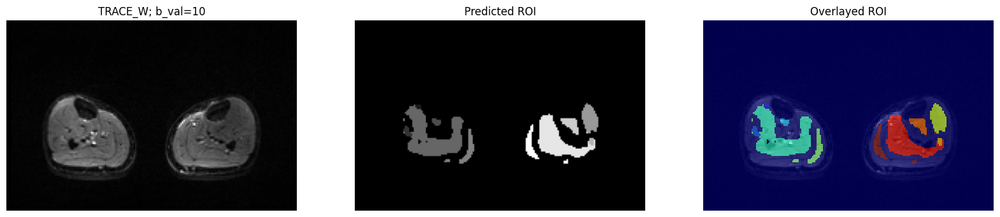

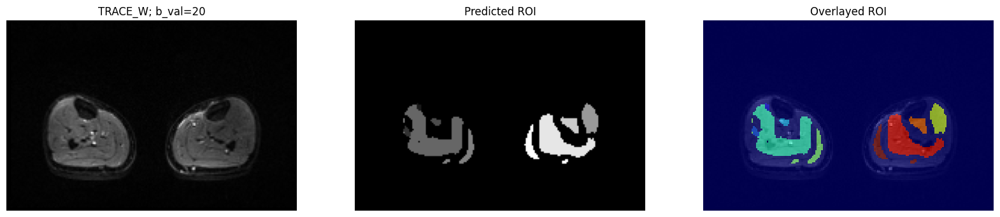

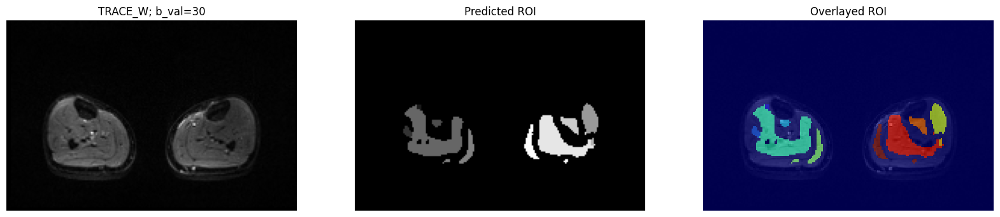

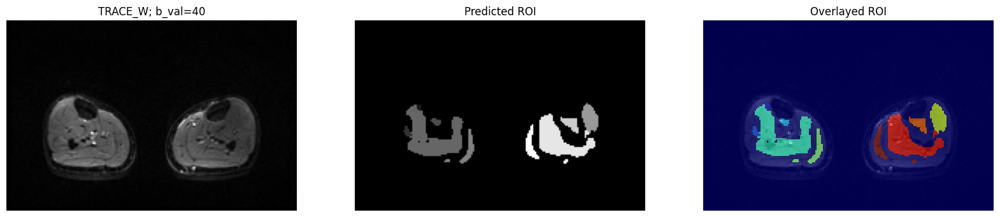

...

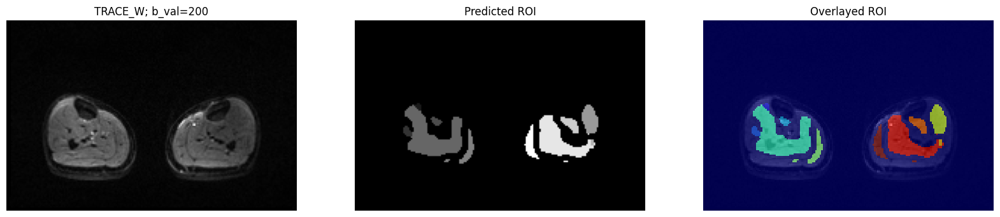

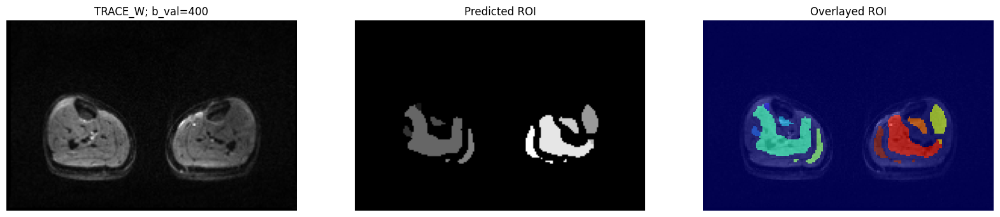

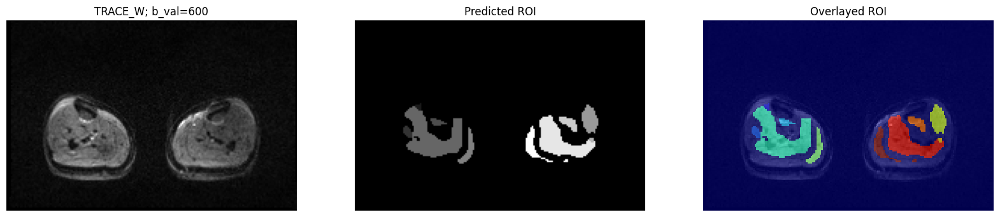

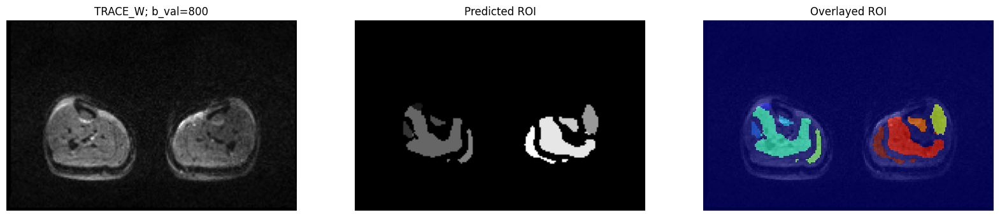

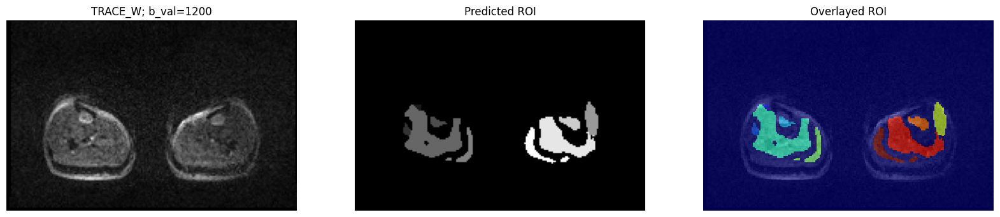

In [283]:
predict_and_plot_export_npy(scanfolders[0]+'/*')

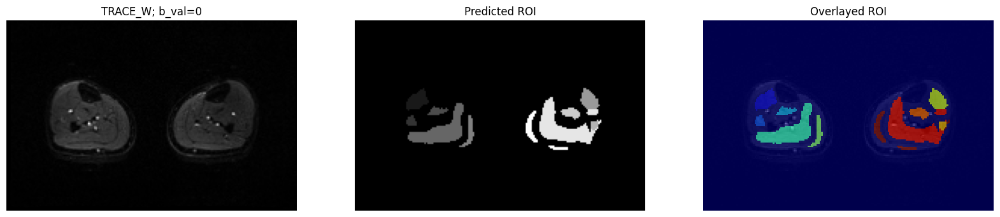

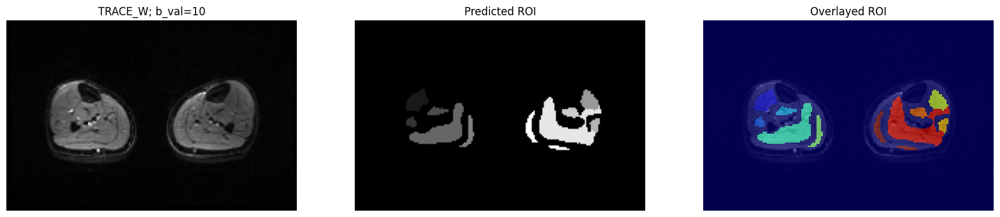

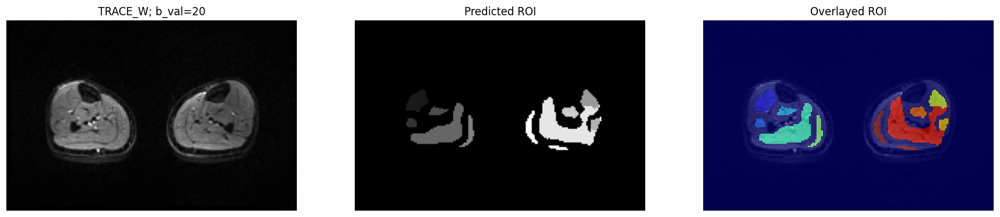

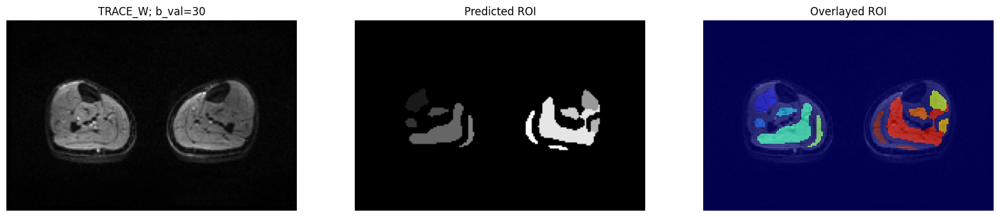

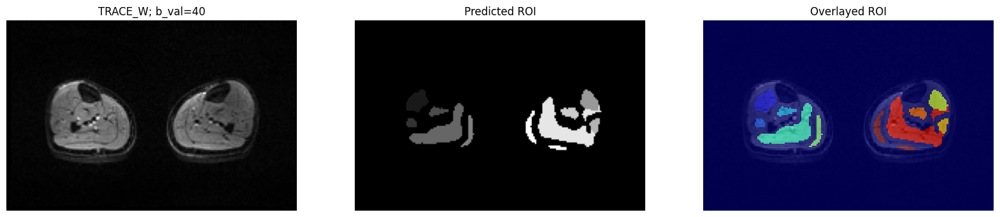

...

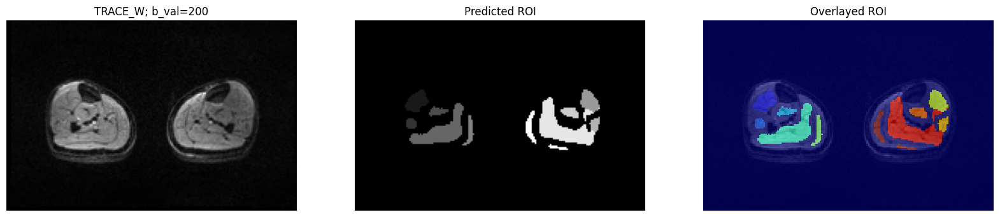

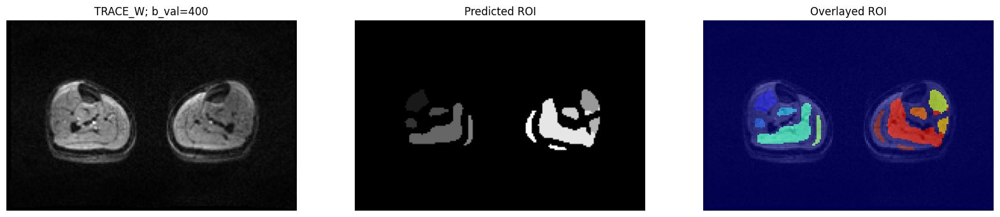

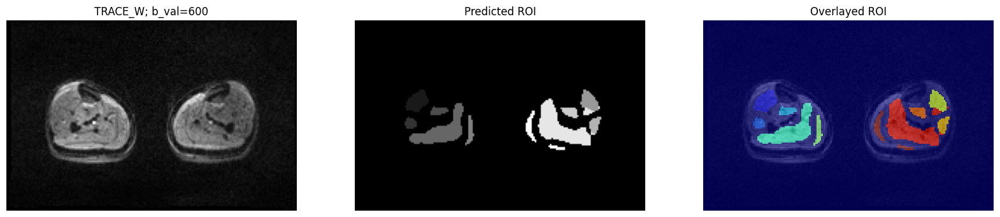

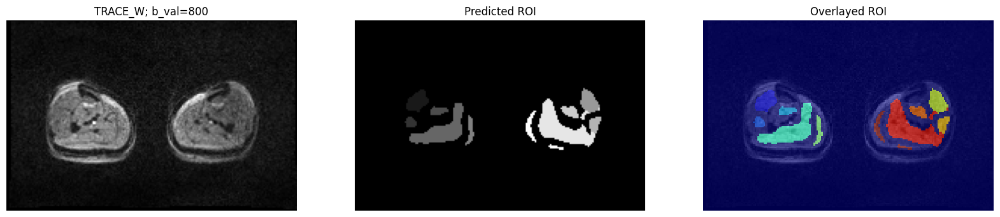

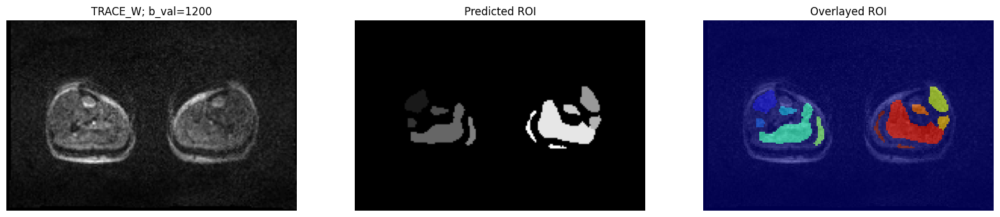

In [284]:
predict_and_plot_export_npy(scanfolders[1]+'/*')

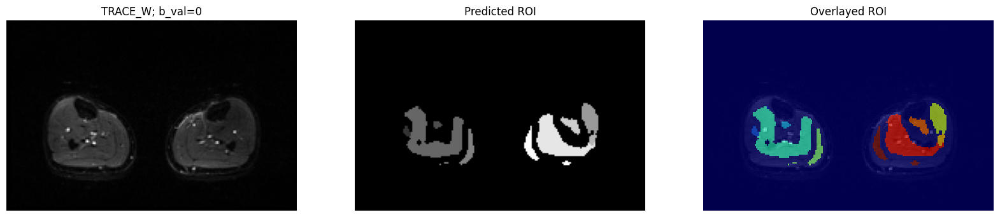

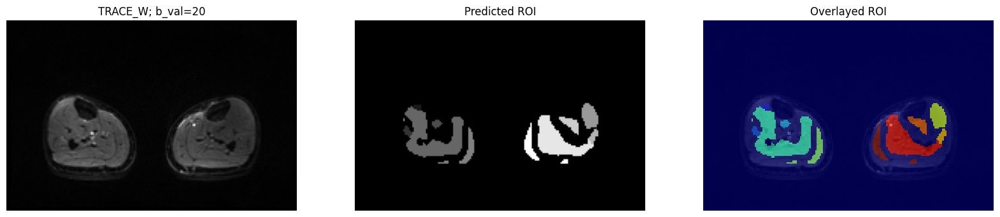

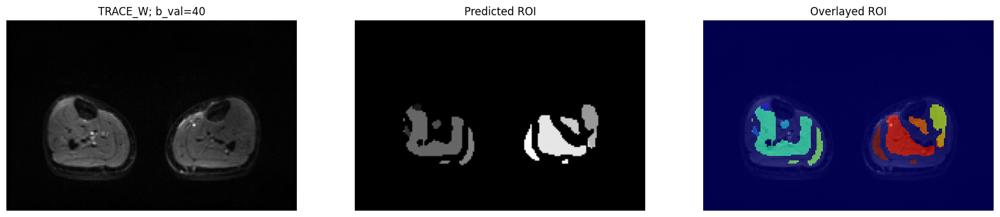

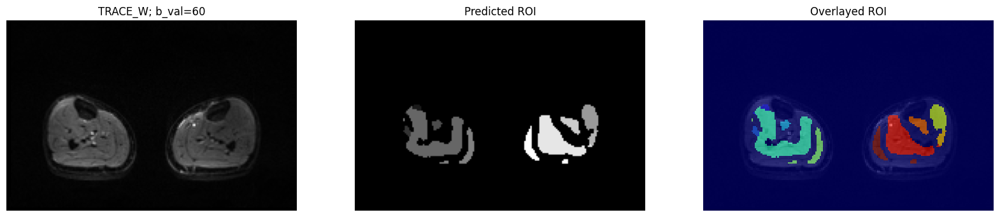

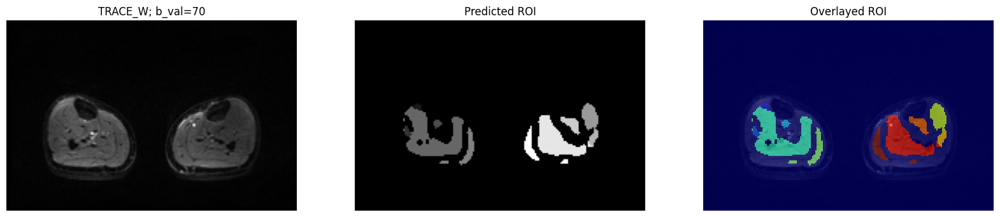

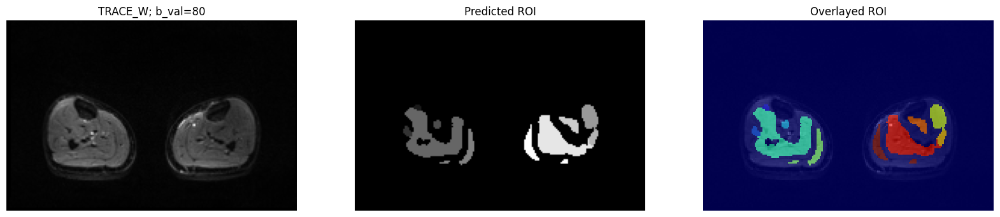

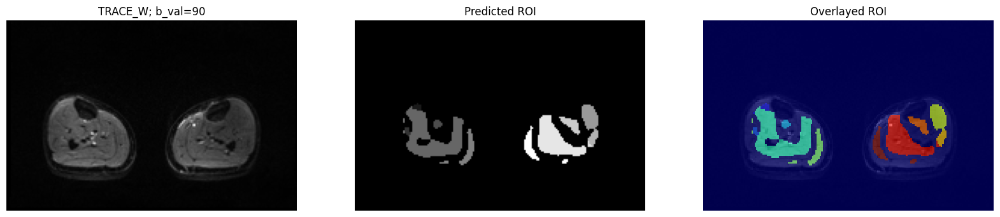

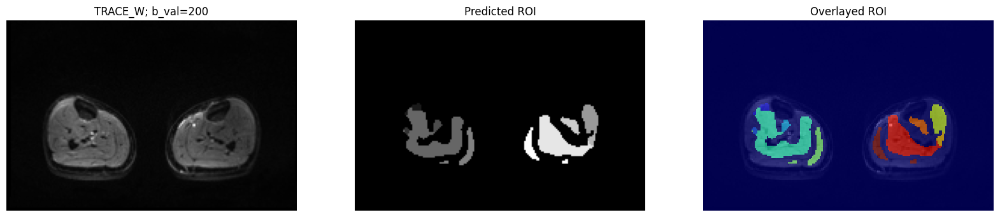

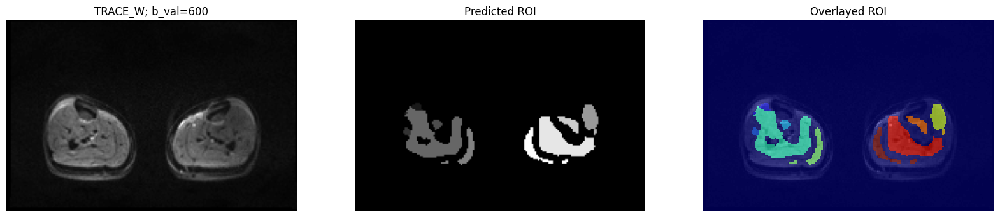

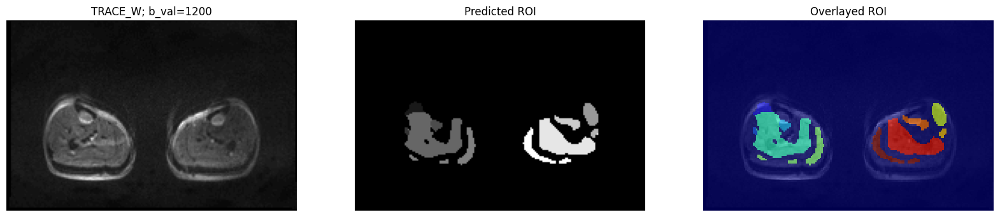

In [285]:
predict_and_plot_export_npy(scanfolders[2]+'/*')

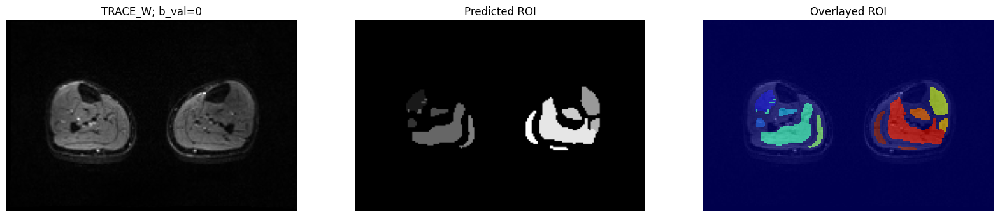

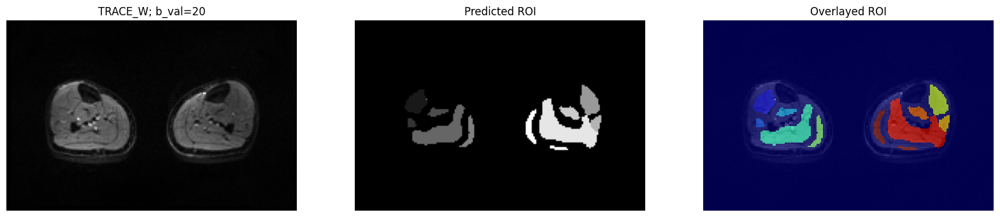

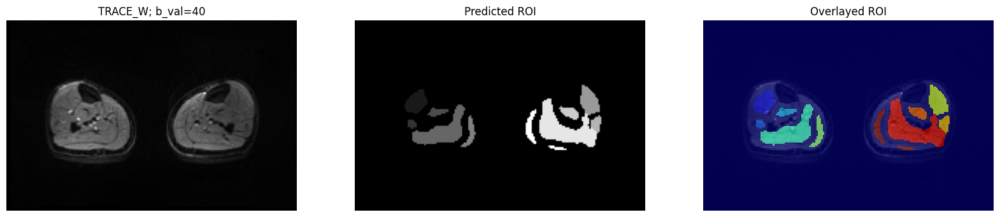

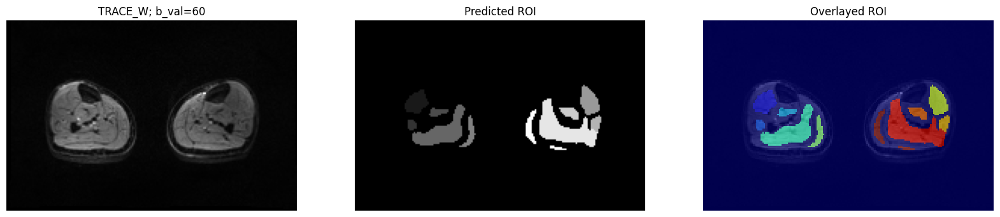

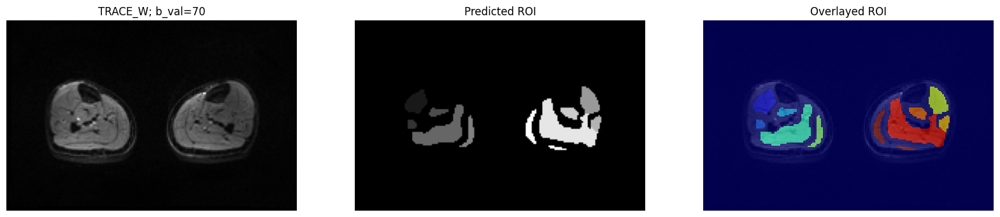

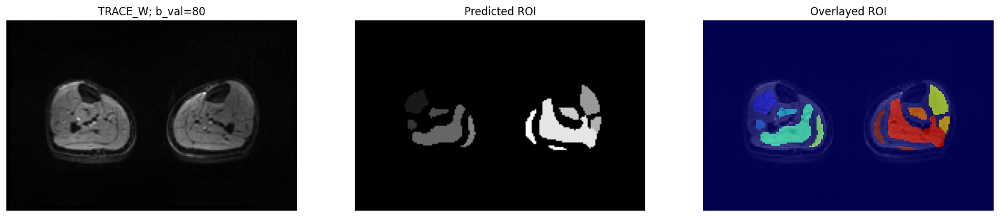

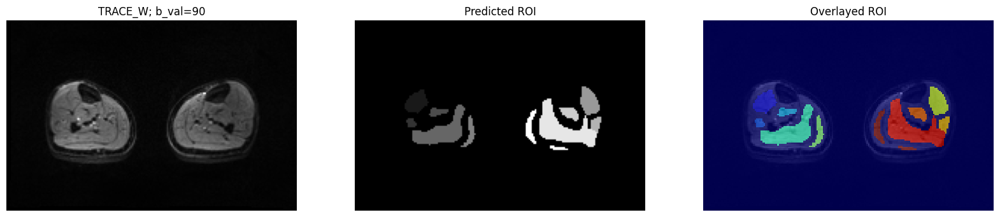

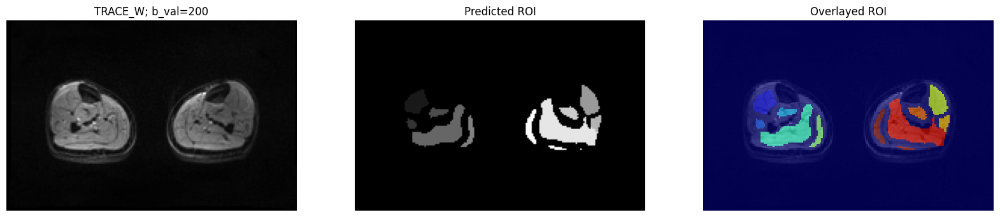

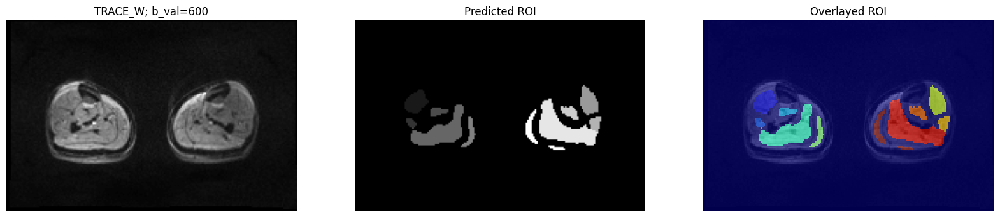

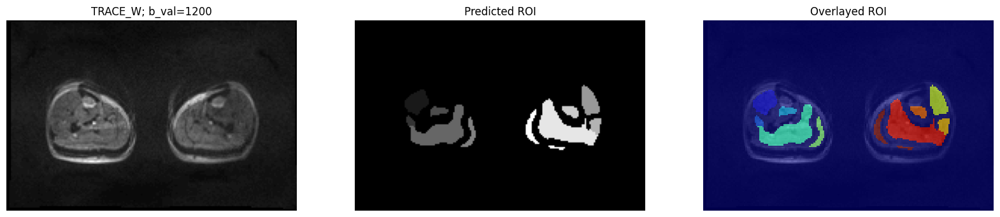

In [286]:
predict_and_plot_export_npy(scanfolders[3]+'/*')

In [287]:
## Now compare results

In [288]:
results_npy = glob.glob('/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/*/*/*/*')

In [289]:
results_npy.sort()
results_npy

['/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008/*/0.npy',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008/*/0.npyroi_roi.npy',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008/*/10.npy',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008/*/10.npyroi_roi.npy',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008/*/100.npy',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008/*/100.npyroi_roi.npy',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008/*/1200.npy',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PM

In [290]:
roi = np.load(results_npy[1])
roi = cv2.resize(roi, (192, 126)) 
threshold = 0.2
roi = (roi >= threshold).astype(int)
roi.shape

(126, 192)

In [291]:
roi = np.load(results_npy[0])
roi = cv2.resize(roi, (192, 126)) 
threshold = 0.2
roi = (roi >= threshold).astype(int)
roi.shape

(126, 192, 10)

In [292]:
each_roi = cv2.split(roi)

In [293]:
def plot_tenrois(rois):
    # Create a figure with subplots
    fig, axes = plt.subplots(2, 5, figsize=(15, 6))  # 2 rows, 5 columns
    
    # Plot each image in a subplot
    for i, ax in enumerate(axes.flat):
        ax.imshow(rois[i], cmap='gray')  # Plot the image
        ax.axis('off')  # Hide the axis
    
    # Adjust layout to prevent overlap
    plt.tight_layout()
    plt.show()

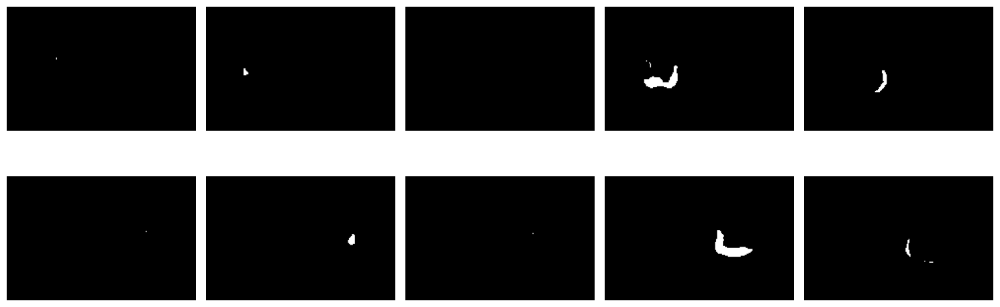

In [294]:
plot_tenrois(each_roi)

In [295]:
np.unique(each_roi)

array([0, 1], dtype=int32)

In [296]:
roi_path = '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/'
test_rois = ['PMRI013_SLICE_1ST_IVIM_ROI/', 'PMRI013_SLICE_2ND_IVIM_ROI/', 'PMRI014_SLICE_1ST_IVIM_ROI/', 'PMRI014_SLICE_2N_IVIM_ROI/', 
             'PMRI015_SLICE_1ST_IVIM_ROI/', 'PMRI015_SLICE_2ND_IVIM_ROI/']

In [297]:
manual_rois = glob.glob(roi_path+'/*/*')
manual_rois.sort()
manual_rois

test_manual_rois = manual_rois[-(4*3):]
test_manual_rois

['/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI013/01 PMRI013_Test_Slice_roi_roitoIVIMbaseline.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI013/02 PMRI013_Retest_Slice_roi_roitoIVIMbaseline.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI013/03 PMRI013_Test_Slice_roi_roitoIVIM_HQ.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI013/04 PMRI013_Retest_Slice_roi_roitoIVIM_HQ.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI014/01 PMRI014_Test_Slice_roi_roitoIVIMbaseline.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI014/02 PMRI014_Retest_Slice_roi_roitoIVIMbaseline.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI014/03 PMRI014_Test_Slice_roi_roitoIVIM_HQ.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_

In [298]:
segmentation_mask = nib.load(test_manual_rois[0]).get_fdata()
segmentation_mask = segmentation_mask.squeeze(axis=(-1, -2))
segmentation_mask = cv2.rotate(segmentation_mask, cv2.ROTATE_90_COUNTERCLOCKWISE)

In [299]:
num_classes = 10
one_hot_mask = np.zeros((126, 192, 10), dtype=np.uint8)
for i in range(1, num_classes + 1):
    one_hot_mask[:, :, i - 1] = (segmentation_mask == i).astype(np.uint8)

In [300]:
np.unique(one_hot_mask)

array([0, 1], dtype=uint8)

In [301]:
one_hot_mask.shape

(126, 192, 10)

In [302]:
one_hot_mask = cv2.split(one_hot_mask)

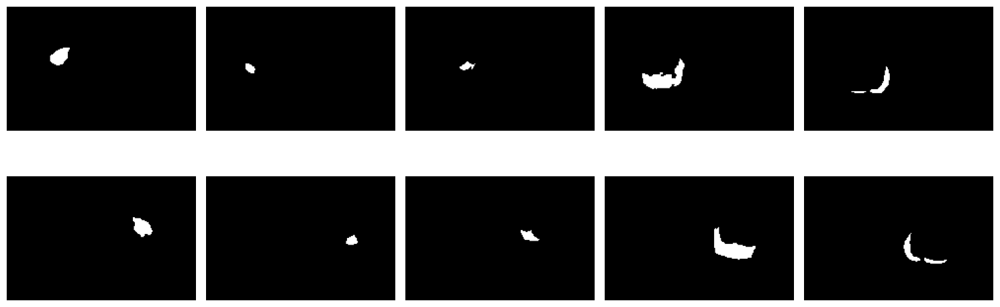

In [303]:
plot_tenrois(one_hot_mask)

In [304]:
predicted_rois_dirs = glob.glob('/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/*/*')
predicted_rois_dirs.sort()
predicted_rois_dirs

['/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0014',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI013/IVIM_HI-Q_TRACEW_0010',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI013/IVIM_HI-Q_TRACEW_0016',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI014/IVIM_BASELINE_TRACEW_0007',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI014/IVIM_BASELINE_TRACEW_0013',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI014/IVIM_HI-Q_TRACEW_0009',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy/PMRI014/IVIM_HI-Q_TRACEW_0015',
 '/mnt/Final_PMRI_repo/lower_limb_calf_muscle_segmentation/results_finetuned_npy

In [305]:
def dice_coefficient2(y_true, y_pred):
    smooth = 1e-6
    intersection = tf.reduce_sum(y_true * y_pred, axis=(1, 2, 3))  # Element-wise multiplication
    union = tf.reduce_sum(y_true, axis=(1, 2, 3)) + tf.reduce_sum(y_pred, axis=(1, 2, 3))
    dice = (2.0 * intersection + smooth) / (union + smooth)
    return tf.reduce_mean(dice)  # Return the average Dice coefficient


def dice_coefficient2(y_true, y_pred):
    smooth = 1e-6
    
    # Ensure the input is numpy arrays (in case they are tensors)
    y_true = np.asarray(y_true)
    y_pred = np.asarray(y_pred)
    
    # Calculate the intersection: sum of element-wise multiplication
    intersection = np.sum(y_true * y_pred)
    
    # Calculate the union: sum of true + predicted values
    union = np.sum(y_true) + np.sum(y_pred)
    
    # Calculate the Dice coefficient
    dice = (2.0 * intersection + smooth) / (union + smooth)
    
    return round(dice, 3)



In [306]:
num_classes = 10
for test_manual_roi, predicted_rois_dir in zip(test_manual_rois, predicted_rois_dirs):
    # load seg mask, manually drawn rois
    
    print('------------------------------------')
    print(predicted_rois_dir[50:])
    print('------------------------------------')
    
    segmentation_mask = nib.load(test_manual_roi).get_fdata()
    segmentation_mask = segmentation_mask.squeeze(axis=(-1, -2))
    segmentation_mask = cv2.rotate(segmentation_mask, cv2.ROTATE_90_COUNTERCLOCKWISE)

    # one hot encode mask
    one_hot_mask = np.zeros((126, 192, 10), dtype=np.uint8)
    for i in range(1, num_classes + 1):
        one_hot_mask[:, :, i - 1] = (segmentation_mask == i).astype(np.uint8)

    # load list of npys
    predicted_rois_list = glob.glob(predicted_rois_dir+'/*/*')
    predicted_rois_list.sort()
    hot_predicted_rois_list = predicted_rois_list[::2] 
    
    for hot_predicted_roi_name in hot_predicted_rois_list:
        #print(hot_predicted_roi_name[76:])
        hot_predicted_roi = np.load(hot_predicted_roi_name)

        #resize predictded rois, threshold, 70%
        hot_predicted_roi = cv2.resize(hot_predicted_roi, (192, 126)) 
        threshold = 0.7
        hot_predicted_roi = (hot_predicted_roi >= threshold).astype(int)

        # split channels
        predictions = cv2.split(hot_predicted_roi)
        true_rois = cv2.split(one_hot_mask)

        dice_scores = []
        for prediction, true_roi in zip(predictions, true_rois):
            #d = dice_coef(true_roi, prediction)
            d = dice_coefficient2(true_roi, prediction)
            dice_scores.append(d)
        print(hot_predicted_roi_name[78:], dice_scores)

------------------------------------
tation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008
------------------------------------
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/0.npy [0.0, 0.0, 0.0, 0.582, 0.456, 0.0, 0.721, 0.0, 0.708, 0.285]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/10.npy [0.264, 0.018, 0.0, 0.607, 0.452, 0.638, 0.65, 0.078, 0.757, 0.416]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/100.npy [0.386, 0.017, 0.222, 0.603, 0.357, 0.579, 0.646, 0.076, 0.747, 0.375]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/1200.npy [0.435, 0.037, 0.333, 0.574, 0.348, 0.569, 0.781, 0.09, 0.7, 0.252]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/20.npy [0.099, 0.0, 0.073, 0.602, 0.371, 0.615, 0.625, 0.047, 0.745, 0.433]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/200.npy [0.392, 0.018, 0.277, 0.603, 0.4, 0.586, 0.679, 0.047, 0.733, 0.359]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/30.npy [0.306, 0.018, 0.118, 0.611, 0.39, 0.592, 0.642, 0.047, 0.738, 0.401]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/40.npy [0.271, 0.018, 0.092, 0.6, 0.389

In [59]:
num_classes = 10
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
for test_manual_roi, predicted_rois_dir in zip(test_manual_rois, predicted_rois_dirs):
    # load seg mask, manually drawn rois
    
    print('------------------------------------')
    print(predicted_rois_dir[50:])
    print('------------------------------------')
    
    segmentation_mask = nib.load(test_manual_roi).get_fdata()
    segmentation_mask = segmentation_mask.squeeze(axis=(-1, -2))
    segmentation_mask = cv2.rotate(segmentation_mask, cv2.ROTATE_90_COUNTERCLOCKWISE)

    # one hot encode mask
    one_hot_mask = np.zeros((126, 192, 10), dtype=np.uint8)
    for i in range(1, num_classes + 1):
        one_hot_mask[:, :, i - 1] = (segmentation_mask == i).astype(np.uint8)

    # load list of npys
    predicted_rois_list = glob.glob(predicted_rois_dir+'/*/*')
    predicted_rois_list.sort()
    hot_predicted_rois_list = predicted_rois_list[::2] 
    
    for hot_predicted_roi_name in hot_predicted_rois_list:
        # print(hot_predicted_roi_name[82:])
        hot_predicted_roi = np.load(hot_predicted_roi_name)

        #resize predictded rois, threshold, 70%
        hot_predicted_roi = cv2.resize(hot_predicted_roi, (192, 126)) 
        threshold = 0.7
        hot_predicted_roi = (hot_predicted_roi >= threshold).astype(int)

        # split channels
        predictions = cv2.split(hot_predicted_roi)
        true_rois = cv2.split(one_hot_mask)

        dice_scores = []
        for prediction, true_roi in zip(predictions, true_rois):
            
            prediction = prediction.astype(np.uint8)
            # dilation
            prediction = cv2.dilate(prediction, kernel, iterations = 1)
            # closing
            prediction = cv2.morphologyEx(prediction, cv2.MORPH_CLOSE, kernel)
            #opening
            prediction = cv2.morphologyEx(prediction, cv2.MORPH_OPEN, kernel)
            # dilation
            prediction = cv2.dilate(prediction, kernel, iterations = 1)


            
            d = dice_coef(true_roi, prediction)
            dice_scores.append(d)
        print(hot_predicted_roi_name[82:], dice_scores)


------------------------------------
tation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008
------------------------------------
I013/IVIM_BASELINE_TRACEW_0008/*/0.npy [0.531, 0.348, 0.705, 0.631, 0.498, 0.648, 0.494, 0.651, 0.729, 0.547]
I013/IVIM_BASELINE_TRACEW_0008/*/10.npy [0.534, 0.353, 0.54, 0.653, 0.548, 0.71, 0.506, 0.621, 0.775, 0.528]
I013/IVIM_BASELINE_TRACEW_0008/*/100.npy [0.528, 0.272, 0.515, 0.726, 0.568, 0.682, 0.509, 0.617, 0.78, 0.513]
I013/IVIM_BASELINE_TRACEW_0008/*/1200.npy [0.518, 0.211, 0.536, 0.724, 0.556, 0.721, 0.558, 0.496, 0.778, 0.539]
I013/IVIM_BASELINE_TRACEW_0008/*/20.npy [0.495, 0.298, 0.521, 0.672, 0.534, 0.696, 0.517, 0.596, 0.767, 0.519]
I013/IVIM_BASELINE_TRACEW_0008/*/200.npy [0.5, 0.288, 0.51, 0.711, 0.57, 0.679, 0.535, 0.61, 0.776, 0.516]
I013/IVIM_BASELINE_TRACEW_0008/*/30.npy [0.559, 0.319, 0.525, 0.71, 0.555, 0.687, 0.525, 0.594, 0.771, 0.515]
I013/IVIM_BASELINE_TRACEW_0008/*/40.npy [0.507, 0.329, 0.523, 0.708, 0.553, 0.685, 0.525, 0.

In [60]:
num_classes = 10
kernel = cv2.getStructuringElement(cv2.MORPH_ELLIPSE, (5, 5))
for test_manual_roi, predicted_rois_dir in zip(test_manual_rois, predicted_rois_dirs):
    # load seg mask, manually drawn rois
    
    print('------------------------------------')
    print(predicted_rois_dir[50:])
    print('------------------------------------')
    
    segmentation_mask = nib.load(test_manual_roi).get_fdata()
    segmentation_mask = segmentation_mask.squeeze(axis=(-1, -2))
    segmentation_mask = cv2.rotate(segmentation_mask, cv2.ROTATE_90_COUNTERCLOCKWISE)

    # one hot encode mask
    one_hot_mask = np.zeros((126, 192, 10), dtype=np.uint8)
    for i in range(1, num_classes + 1):
        one_hot_mask[:, :, i - 1] = (segmentation_mask == i).astype(np.uint8)

    # load list of npys
    predicted_rois_list = glob.glob(predicted_rois_dir+'/*/*')
    predicted_rois_list.sort()
    hot_predicted_rois_list = predicted_rois_list[::2] 
    
    for hot_predicted_roi_name in hot_predicted_rois_list:
        # print(hot_predicted_roi_name[82:])
        hot_predicted_roi = np.load(hot_predicted_roi_name)

        #resize predictded rois, threshold, 70%
        hot_predicted_roi = cv2.resize(hot_predicted_roi, (192, 126)) 
        threshold = 0.7
        hot_predicted_roi = (hot_predicted_roi >= threshold).astype(int)

        # split channels
        predictions = cv2.split(hot_predicted_roi)
        true_rois = cv2.split(one_hot_mask)

        dice_scores = []
        for prediction, true_roi in zip(predictions, true_rois):
            prediction = prediction.astype(np.uint8)
            # dilation
            prediction = cv2.dilate(prediction, kernel, iterations = 1)
            # closing
            #prediction = cv2.morphologyEx(prediction, cv2.MORPH_CLOSE, kernel)
            #opening
            prediction = cv2.morphologyEx(prediction, cv2.MORPH_OPEN, kernel)
            # dilation
            prediction = cv2.dilate(prediction, kernel, iterations = 1)
            d = dice_coef(true_roi, prediction)
            dice_scores.append(d)
        print(hot_predicted_roi_name[82:], dice_scores)


# m3 and m8 improves here???

------------------------------------
tation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008
------------------------------------
I013/IVIM_BASELINE_TRACEW_0008/*/0.npy [0.531, 0.348, 0.705, 0.631, 0.498, 0.648, 0.494, 0.651, 0.729, 0.547]
I013/IVIM_BASELINE_TRACEW_0008/*/10.npy [0.534, 0.353, 0.54, 0.653, 0.548, 0.71, 0.506, 0.621, 0.775, 0.528]
I013/IVIM_BASELINE_TRACEW_0008/*/100.npy [0.528, 0.272, 0.515, 0.726, 0.568, 0.682, 0.509, 0.617, 0.78, 0.513]
I013/IVIM_BASELINE_TRACEW_0008/*/1200.npy [0.518, 0.211, 0.536, 0.724, 0.556, 0.721, 0.558, 0.496, 0.778, 0.539]
I013/IVIM_BASELINE_TRACEW_0008/*/20.npy [0.495, 0.298, 0.521, 0.672, 0.534, 0.696, 0.517, 0.596, 0.767, 0.519]
I013/IVIM_BASELINE_TRACEW_0008/*/200.npy [0.5, 0.288, 0.51, 0.711, 0.57, 0.679, 0.535, 0.61, 0.776, 0.516]
I013/IVIM_BASELINE_TRACEW_0008/*/30.npy [0.559, 0.319, 0.525, 0.71, 0.555, 0.687, 0.525, 0.594, 0.771, 0.515]
I013/IVIM_BASELINE_TRACEW_0008/*/40.npy [0.507, 0.329, 0.523, 0.708, 0.553, 0.685, 0.525, 0.

In [61]:
num_classes = 10
for test_manual_roi, predicted_rois_dir in zip(test_manual_rois, predicted_rois_dirs):
    # load seg mask, manually drawn rois
    
    print('------------------------------------')
    print(predicted_rois_dir[50:])
    print('------------------------------------')
    
    segmentation_mask = nib.load(test_manual_roi).get_fdata()
    segmentation_mask = segmentation_mask.squeeze(axis=(-1, -2))
    segmentation_mask = cv2.rotate(segmentation_mask, cv2.ROTATE_90_COUNTERCLOCKWISE)

    # one hot encode mask
    one_hot_mask = np.zeros((126, 192, 10), dtype=np.uint8)
    for i in range(1, num_classes + 1):
        one_hot_mask[:, :, i - 1] = (segmentation_mask == i).astype(np.uint8)

    # load list of npys
    predicted_rois_list = glob.glob(predicted_rois_dir+'/*/*')
    predicted_rois_list.sort()
    hot_predicted_rois_list = predicted_rois_list[::2] 
    
    for hot_predicted_roi_name in hot_predicted_rois_list:
        # print(hot_predicted_roi_name[82:])
        hot_predicted_roi = np.load(hot_predicted_roi_name)

        #resize predictded rois, threshold, 70%
        hot_predicted_roi = cv2.resize(hot_predicted_roi, (192, 126)) 
        threshold = 0.7
        hot_predicted_roi = (hot_predicted_roi >= threshold).astype(int)

        # split channels
        predictions = cv2.split(hot_predicted_roi)
        true_rois = cv2.split(one_hot_mask)

        # Convert back to uint8
        predictions = [np.uint8(np.clip(i,0,255)) for prediction in predictions]

        dice_scores = []
        for prediction, true_roi in zip(predictions, true_rois):
            prediction_ = cv2.fastNlMeansDenoisingMulti(prediction, 0, 1, None, 4, 7, 35)
            d = dice_coef(true_roi, prediction_)
            dice_scores.append(d)
        print(hot_predicted_roi_name[82:], dice_scores)

------------------------------------
tation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008
------------------------------------


error: OpenCV(4.9.0) :-1: error: (-5:Bad argument) in function 'fastNlMeansDenoisingMulti'
> Overload resolution failed:
>  - Can't parse 'srcImgs'. Input argument doesn't provide sequence protocol
>  - Can't parse 'srcImgs'. Input argument doesn't provide sequence protocol
>  - Can't parse 'srcImgs'. Input argument doesn't provide sequence protocol
>  - Can't parse 'srcImgs'. Input argument doesn't provide sequence protocol


In [62]:
se=cv2.getStructuringElement(cv2.MORPH_RECT , (8,8))
bg=cv2.morphologyEx(image, cv2.MORPH_DILATE, se)
out_gray=cv2.divide(image, bg, scale=255)
out_binary=cv2.threshold(out_gray, 0, 255, cv2.THRESH_OTSU )[1] 

NameError: name 'image' is not defined

In [63]:
num_classes = 10
for test_manual_roi, predicted_rois_dir in zip(test_manual_rois, predicted_rois_dirs):
    # load seg mask, manually drawn rois
    
    print('------------------------------------')
    print(predicted_rois_dir[50:])
    print('------------------------------------')
    
    segmentation_mask = nib.load(test_manual_roi).get_fdata()
    segmentation_mask = segmentation_mask.squeeze(axis=(-1, -2))
    segmentation_mask = cv2.rotate(segmentation_mask, cv2.ROTATE_90_COUNTERCLOCKWISE)

    # one hot encode mask
    one_hot_mask = np.zeros((126, 192, 10), dtype=np.uint8)
    for i in range(1, num_classes + 1):
        one_hot_mask[:, :, i - 1] = (segmentation_mask == i).astype(np.uint8)

    # load list of npys
    predicted_rois_list = glob.glob(predicted_rois_dir+'/*/*')
    predicted_rois_list.sort()
    hot_predicted_rois_list = predicted_rois_list[::2] 
    
    for hot_predicted_roi_name in hot_predicted_rois_list:
        # print(hot_predicted_roi_name[82:])
        hot_predicted_roi = np.load(hot_predicted_roi_name)

        #resize predictded rois, threshold, 70%
        hot_predicted_roi = cv2.resize(hot_predicted_roi, (192, 126)) 
        threshold = 0.7
        hot_predicted_roi = (hot_predicted_roi >= threshold).astype(int)

        # split channels
        predictions = cv2.split(hot_predicted_roi)
        true_rois = cv2.split(one_hot_mask)

        dice_scores = []
        for prediction, true_roi in zip(predictions, true_rois):
            prediction_ = prediction_.astype(np.uint8)
            #print(type(prediction_))
            #prediction_=cv2.cvtColor(prediction_,cv2.COLOR_BGR2GRAY)
            se=cv2.getStructuringElement(cv2.MORPH_RECT , (8,8))
            bg=cv2.morphologyEx(prediction_, cv2.MORPH_DILATE, se)
            prediction__gray=cv2.divide(prediction_, bg, scale=255)
            #prediction__binary=cv2.threshold(prediction__gray, 0, 255, cv2.THRESH_OTSU )[1] 

            d = dice_coef(true_roi, prediction__gray/255)
            dice_scores.append(d)
        print(hot_predicted_roi_name[82:], dice_scores)

------------------------------------
tation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008
------------------------------------


NameError: name 'prediction_' is not defined

In [64]:
num_classes = 10
for test_manual_roi, predicted_rois_dir in zip(test_manual_rois, predicted_rois_dirs):
    # load seg mask, manually drawn rois
    
    print('------------------------------------')
    print(predicted_rois_dir[50:])
    print('------------------------------------')
    
    segmentation_mask = nib.load(test_manual_roi).get_fdata()
    segmentation_mask = segmentation_mask.squeeze(axis=(-1, -2))
    segmentation_mask = cv2.rotate(segmentation_mask, cv2.ROTATE_90_COUNTERCLOCKWISE)

    # one hot encode mask
    one_hot_mask = np.zeros((126, 192, 10), dtype=np.uint8)
    for i in range(1, num_classes + 1):
        one_hot_mask[:, :, i - 1] = (segmentation_mask == i).astype(np.uint8)

    # load list of npys
    predicted_rois_list = glob.glob(predicted_rois_dir+'/*/*')
    predicted_rois_list.sort()
    hot_predicted_rois_list = predicted_rois_list[::2] 
    
    for hot_predicted_roi_name in hot_predicted_rois_list:
        # print(hot_predicted_roi_name[82:])
        hot_predicted_roi = np.load(hot_predicted_roi_name)

        #resize predictded rois, threshold, 70%
        hot_predicted_roi = cv2.resize(hot_predicted_roi, (192, 126)) 
        threshold = 0.7
        hot_predicted_roi = (hot_predicted_roi >= threshold).astype(int)

        # split channels
        predictions = cv2.split(hot_predicted_roi)
        true_rois = cv2.split(one_hot_mask)

        dice_scores = []
        for prediction, true_roi in zip(predictions, true_rois):
            prediction_ = prediction_.astype(np.uint8)

            se=cv2.getStructuringElement(cv2.MORPH_RECT , (8,8))
            bg=cv2.morphologyEx(prediction_, cv2.MORPH_DILATE, se)
            prediction__gray=cv2.divide(prediction_, bg, scale=255)
            prediction__binary=cv2.threshold(prediction__gray, 0, 255, cv2.THRESH_OTSU )[1] 

            d = dice_coef(true_roi, prediction__binary)
            dice_scores.append(d)
        print(hot_predicted_roi_name[82:], dice_scores)

------------------------------------
tation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008
------------------------------------


NameError: name 'prediction_' is not defined

In [65]:
roi_path = '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/'
test_rois = ['PMRI013_SLICE_1ST_IVIM_ROI/', 'PMRI013_SLICE_2ND_IVIM_ROI/', 'PMRI014_SLICE_1ST_IVIM_ROI/', 'PMRI014_SLICE_2N_IVIM_ROI/', 
             'PMRI015_SLICE_1ST_IVIM_ROI/', 'PMRI015_SLICE_2ND_IVIM_ROI/']

In [66]:
manual_rois = glob.glob(roi_path+'/*/*')
manual_rois.sort()
manual_rois

test_manual_rois = manual_rois[-(4*3):]
test_manual_rois

['/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI013/01 PMRI013_Test_Slice_roi_roitoIVIMbaseline.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI013/02 PMRI013_Retest_Slice_roi_roitoIVIMbaseline.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI013/03 PMRI013_Test_Slice_roi_roitoIVIM_HQ.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI013/04 PMRI013_Retest_Slice_roi_roitoIVIM_HQ.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI014/01 PMRI014_Test_Slice_roi_roitoIVIMbaseline.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI014/02 PMRI014_Retest_Slice_roi_roitoIVIMbaseline.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_Dataset/SegMask/01_ivim_seg_mask/ROI_PMRI014/03 PMRI014_Test_Slice_roi_roitoIVIM_HQ.nii',
 '/home/besanhalwa/Eshan/data/SegData/PMRI_

In [67]:
segmentation_mask = nib.load(test_manual_rois[0]).get_fdata()
segmentation_mask = segmentation_mask.squeeze(axis=(-1, -2))
segmentation_mask = cv2.rotate(segmentation_mask, cv2.ROTATE_90_COUNTERCLOCKWISE)

In [68]:
num_classes = 10
one_hot_mask = np.zeros((126, 192, 10), dtype=np.uint8)
for i in range(1, num_classes + 1):
    one_hot_mask[:, :, i - 1] = (segmentation_mask == i).astype(np.uint8)

In [69]:
np.unique(one_hot_mask)

array([0, 1], dtype=uint8)

In [70]:
one_hot_mask = cv2.split(one_hot_mask)

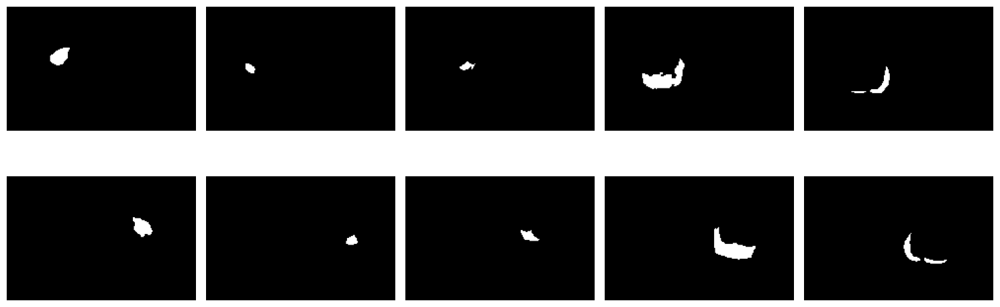

In [71]:
plot_tenrois(one_hot_mask)

In [72]:
roi_reduce_noise_grey = []
roi_reduce_noise_binary = []
for prediction in predictions:
    prediction_ = prediction.astype(np.uint8)

    se=cv2.getStructuringElement(cv2.MORPH_RECT , (8,8))
    bg=cv2.morphologyEx(prediction_, cv2.MORPH_DILATE, se)
    prediction__gray=cv2.divide(prediction_, bg, scale=255)
    prediction__binary=cv2.threshold(prediction__gray, 0, 255, cv2.THRESH_OTSU )[1] 
    roi_reduce_noise_grey.append(prediction__gray)
    roi_reduce_noise_binary.append(prediction__binary)

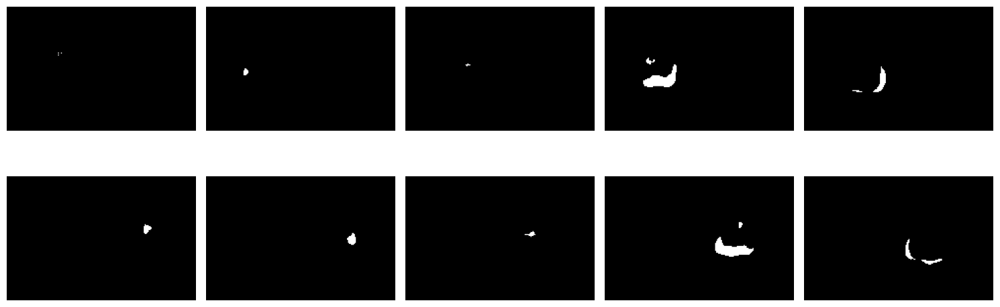

In [73]:
plot_tenrois(roi_reduce_noise_grey)

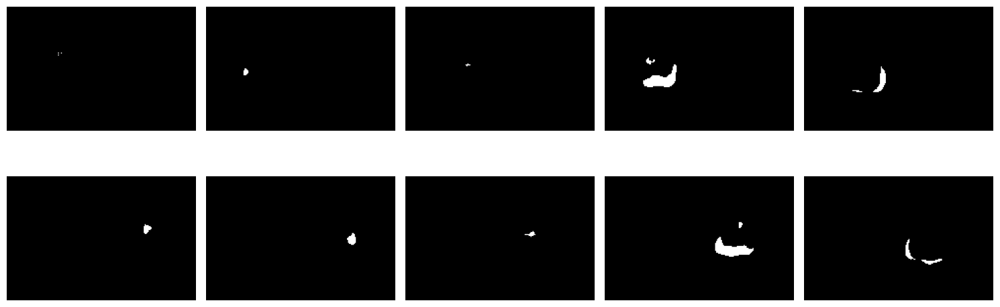

In [74]:
plot_tenrois(roi_reduce_noise_binary)

In [75]:
np.unique(roi_reduce_noise_binary[0]/255)

array([0., 1.])

In [76]:
type(roi_reduce_noise_binary)

list

In [77]:
segmentation_mask = nib.load(test_manual_rois[0]).get_fdata()
segmentation_mask = segmentation_mask.squeeze(axis=(-1, -2))
segmentation_mask = cv2.rotate(segmentation_mask, cv2.ROTATE_90_COUNTERCLOCKWISE)

num_classes = 10
one_hot_mask = np.zeros((126, 192, 10), dtype=np.uint8)
for i in range(1, num_classes + 1):
    one_hot_mask[:, :, i - 1] = (segmentation_mask == i).astype(np.uint8)

one_hot_mask = cv2.split(one_hot_mask)

predictions_dilate = []
predictions_dilate_two = []
predictions_morph = []
predictions_morph_two = []

for prediction in predictions:
    prediction_ = prediction.astype(np.uint8)

    prediction = prediction.astype(np.uint8)
    # dilation
    prediction_dilate = cv2.dilate(prediction, kernel, iterations = 1)
    # closing
    prediction_morph = cv2.morphologyEx(prediction, cv2.MORPH_CLOSE, kernel)
    #opening
    prediction_morph_two = cv2.morphologyEx(prediction, cv2.MORPH_OPEN, kernel)
    # dilation
    prediction_dilate_two = cv2.dilate(prediction, kernel, iterations = 1)

    predictions_dilate.append(prediction_dilate)
    predictions_dilate_two.append(prediction_dilate_two)
    predictions_morph.append(prediction_morph)
    predictions_morph_two.append(prediction_morph_two)

    roi_reduce_noise_grey.append(prediction__gray)
    roi_reduce_noise_binary.append(prediction__binary)

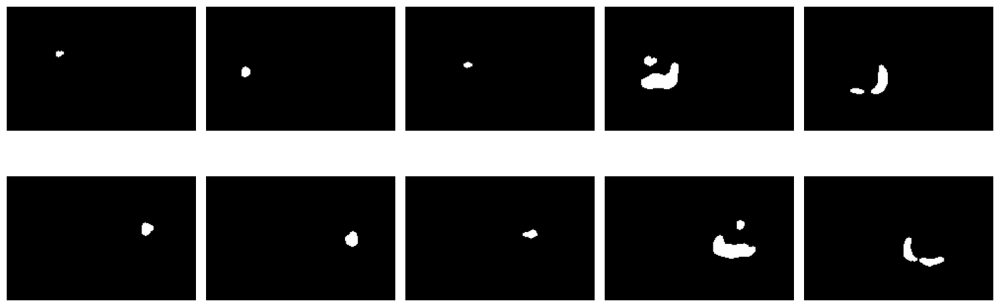

In [78]:
plot_tenrois(predictions_dilate)   

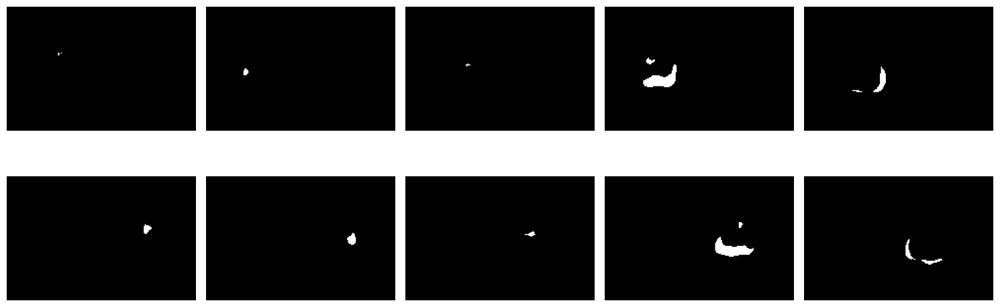

In [79]:
plot_tenrois(predictions_morph)

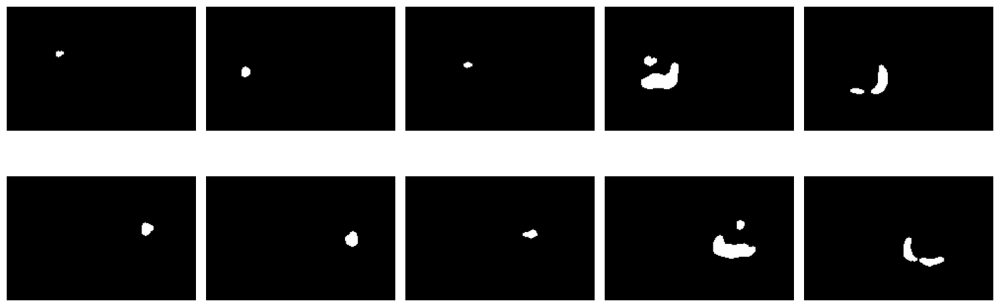

In [80]:
plot_tenrois(predictions_dilate_two)

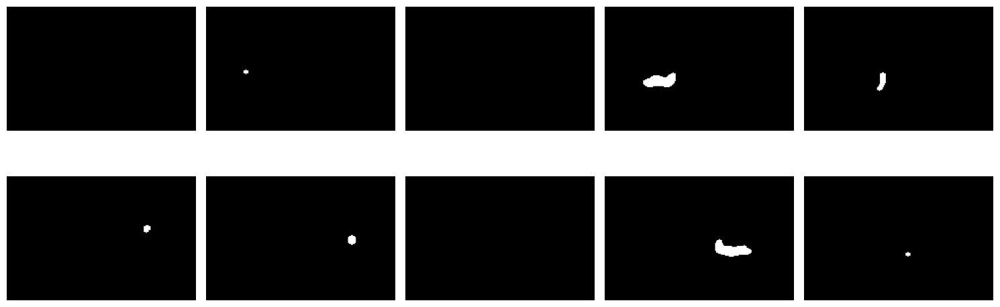

In [81]:
plot_tenrois(predictions_morph_two)

In [82]:
num_classes = 10
for test_manual_roi, predicted_rois_dir in zip(test_manual_rois, predicted_rois_dirs):
    # load seg mask, manually drawn rois
    
    print('------------------------------------')
    print(predicted_rois_dir[50:])
    print('------------------------------------')
    
    segmentation_mask = nib.load(test_manual_roi).get_fdata()
    segmentation_mask = segmentation_mask.squeeze(axis=(-1, -2))
    segmentation_mask = cv2.rotate(segmentation_mask, cv2.ROTATE_90_COUNTERCLOCKWISE)

    # one hot encode mask
    one_hot_mask = np.zeros((126, 192, 10), dtype=np.uint8)
    for i in range(1, num_classes + 1):
        one_hot_mask[:, :, i - 1] = (segmentation_mask == i).astype(np.uint8)

    # load list of npys
    predicted_rois_list = glob.glob(predicted_rois_dir+'/*/*')
    predicted_rois_list.sort()
    hot_predicted_rois_list = predicted_rois_list[::2] 
    
    for hot_predicted_roi_name in hot_predicted_rois_list:
        # print(hot_predicted_roi_name[82:])
        hot_predicted_roi = np.load(hot_predicted_roi_name)

        #resize predictded rois, threshold, 70%
        hot_predicted_roi = cv2.resize(hot_predicted_roi, (192, 126)) 
        threshold = 0.7
        hot_predicted_roi = (hot_predicted_roi >= threshold).astype(int)

        # split channels
        predictions = cv2.split(hot_predicted_roi)
        true_rois = cv2.split(one_hot_mask)

        dice_scores = []
        for prediction, true_roi in zip(predictions, true_rois):
            prediction_ = prediction_.astype(np.uint8)

            #prediction_ = cv2.dilate(prediction_, kernel, iterations = 1)
            #prediction_ = cv2.dilate(prediction_, kernel, iterations = 1)
            #se=cv2.getStructuringElement(cv2.MORPH_RECT , (8,8))
            #bg=cv2.morphologyEx(prediction_, cv2.MORPH_DILATE, se)
            #prediction__gray=cv2.divide(prediction_, bg, scale=255)
            #prediction__binary=cv2.threshold(prediction__gray, 0, 255, cv2.THRESH_OTSU )[1] 
            #erosion
            #prediction_ = cv2.morphologyEx(prediction__binary, cv2.MORPH_OPEN, kernel)

            d = dice_coef(true_roi, prediction__binary/255)
            dice_scores.append(d)
        print(hot_predicted_roi_name[82:], dice_scores)

------------------------------------
tation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008
------------------------------------
I013/IVIM_BASELINE_TRACEW_0008/*/0.npy [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003, 0.559]
I013/IVIM_BASELINE_TRACEW_0008/*/10.npy [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003, 0.559]
I013/IVIM_BASELINE_TRACEW_0008/*/100.npy [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003, 0.559]
I013/IVIM_BASELINE_TRACEW_0008/*/1200.npy [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003, 0.559]
I013/IVIM_BASELINE_TRACEW_0008/*/20.npy [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003, 0.559]
I013/IVIM_BASELINE_TRACEW_0008/*/200.npy [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003, 0.559]
I013/IVIM_BASELINE_TRACEW_0008/*/30.npy [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003, 0.559]
I013/IVIM_BASELINE_TRACEW_0008/*/40.npy [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003, 0.559]
I013/IVIM_BASELINE_TRACEW_0008/*/400.npy [0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.0, 0.003, 0.559]
I013

In [83]:
NON FINETUNED RESULTS 

------------------------------------
/PMRI013/IVIM_BASELINE_TRACEW_0008
------------------------------------
08/*/0.npy [0.661, 0.417, 0.19, 0.726, 0.652, 0.359, 0.614, 0.336, 0.744, 0.535]
08/*/10.npy [0.523, 0.124, 0.33, 0.674, 0.691, 0.461, 0.453, 0.56, 0.808, 0.534]
08/*/100.npy [0.563, 0.319, 0.582, 0.719, 0.665, 0.468, 0.444, 0.5, 0.82, 0.533]
08/*/1200.npy [0.591, 0.281, 0.683, 0.76, 0.704, 0.527, 0.581, 0.5, 0.821, 0.458]
08/*/20.npy [0.514, 0.141, 0.444, 0.681, 0.669, 0.479, 0.411, 0.523, 0.812, 0.523]
08/*/200.npy [0.57, 0.371, 0.607, 0.721, 0.677, 0.469, 0.449, 0.5, 0.822, 0.541]
08/*/30.npy [0.523, 0.255, 0.424, 0.682, 0.683, 0.457, 0.414, 0.491, 0.816, 0.546]
08/*/40.npy [0.519, 0.259, 0.485, 0.686, 0.681, 0.467, 0.425, 0.494, 0.815, 0.541]
08/*/400.npy [0.56, 0.366, 0.602, 0.727, 0.662, 0.487, 0.524, 0.503, 0.823, 0.52]
08/*/50.npy [0.519, 0.273, 0.542, 0.704, 0.677, 0.464, 0.414, 0.512, 0.815, 0.538]
08/*/60.npy [0.541, 0.278, 0.556, 0.69, 0.654, 0.452, 0.428, 0.491, 0.814, 0.553]
08/*/600.npy [0.555, 0.308, 0.655, 0.727, 0.636, 0.495, 0.5, 0.494, 0.832, 0.482]
08/*/70.npy [0.559, 0.317, 0.542, 0.702, 0.667, 0.472, 0.417, 0.491, 0.822, 0.53]
08/*/80.npy [0.584, 0.319, 0.542, 0.71, 0.669, 0.487, 0.44, 0.494, 0.819, 0.561]
08/*/800.npy [0.514, 0.283, 0.719, 0.734, 0.646, 0.494, 0.507, 0.486, 0.832, 0.478]
08/*/90.npy [0.587, 0.341, 0.528, 0.718, 0.681, 0.495, 0.428, 0.52, 0.817, 0.552]
------------------------------------
/PMRI013/IVIM_BASELINE_TRACEW_0014
------------------------------------
14/*/0.npy [0.57, 0.142, 0.0, 0.76, 0.583, 0.633, 0.63, 0.4, 0.678, 0.534]
14/*/10.npy [0.498, 0.227, 0.236, 0.753, 0.685, 0.632, 0.516, 0.486, 0.728, 0.533]
14/*/100.npy [0.535, 0.3, 0.365, 0.753, 0.619, 0.657, 0.643, 0.486, 0.729, 0.509]
14/*/1200.npy [0.518, 0.031, 0.548, 0.768, 0.411, 0.608, 0.72, 0.521, 0.768, 0.354]
14/*/20.npy [0.512, 0.279, 0.29, 0.767, 0.647, 0.632, 0.532, 0.496, 0.741, 0.53]
14/*/200.npy [0.527, 0.286, 0.365, 0.752, 0.577, 0.653, 0.655, 0.5, 0.738, 0.505]
14/*/30.npy [0.498, 0.294, 0.316, 0.768, 0.633, 0.642, 0.528, 0.507, 0.735, 0.534]
14/*/40.npy [0.509, 0.29, 0.316, 0.764, 0.624, 0.645, 0.568, 0.496, 0.731, 0.526]
14/*/400.npy [0.525, 0.282, 0.411, 0.746, 0.575, 0.645, 0.639, 0.542, 0.756, 0.465]
14/*/50.npy [0.503, 0.277, 0.316, 0.765, 0.637, 0.647, 0.568, 0.5, 0.728, 0.511]
14/*/60.npy [0.518, 0.288, 0.29, 0.755, 0.649, 0.647, 0.577, 0.486, 0.739, 0.51]
14/*/600.npy [0.545, 0.261, 0.438, 0.741, 0.515, 0.637, 0.671, 0.562, 0.767, 0.433]
14/*/70.npy [0.511, 0.3, 0.328, 0.768, 0.633, 0.64, 0.568, 0.503, 0.736, 0.532]
14/*/80.npy [0.518, 0.288, 0.328, 0.766, 0.629, 0.657, 0.577, 0.496, 0.738, 0.518]
14/*/800.npy [0.545, 0.207, 0.48, 0.74, 0.491, 0.644, 0.638, 0.613, 0.786, 0.395]
14/*/90.npy [0.525, 0.292, 0.353, 0.776, 0.616, 0.657, 0.556, 0.507, 0.738, 0.499]
------------------------------------
/PMRI013/IVIM_HI-Q_TRACEW_0010
------------------------------------
/0.npy [0.654, 0.27, 0.404, 0.69, 0.711, 0.467, 0.65, 0.533, 0.744, 0.576]
/1200.npy [0.56, 0.246, 0.607, 0.707, 0.689, 0.504, 0.662, 0.494, 0.809, 0.426]
/20.npy [0.571, 0.21, 0.386, 0.663, 0.677, 0.49, 0.5, 0.512, 0.806, 0.566]
/200.npy [0.588, 0.303, 0.492, 0.694, 0.688, 0.496, 0.612, 0.523, 0.812, 0.562]
/40.npy [0.566, 0.21, 0.386, 0.667, 0.644, 0.496, 0.51, 0.523, 0.81, 0.567]
/60.npy [0.576, 0.222, 0.427, 0.678, 0.681, 0.484, 0.524, 0.517, 0.808, 0.564]
/600.npy [0.57, 0.295, 0.543, 0.694, 0.682, 0.501, 0.626, 0.52, 0.812, 0.51]
/70.npy [0.559, 0.273, 0.454, 0.68, 0.679, 0.479, 0.531, 0.523, 0.807, 0.558]
/80.npy [0.598, 0.222, 0.441, 0.669, 0.66, 0.483, 0.544, 0.523, 0.811, 0.575]
/90.npy [0.603, 0.268, 0.454, 0.669, 0.662, 0.486, 0.544, 0.523, 0.806, 0.547]
------------------------------------
/PMRI013/IVIM_HI-Q_TRACEW_0016
------------------------------------
/0.npy [0.623, 0.093, 0.0, 0.77, 0.635, 0.63, 0.603, 0.27, 0.713, 0.529]
/1200.npy [0.596, 0.0, 0.555, 0.743, 0.466, 0.62, 0.702, 0.493, 0.778, 0.312]
/20.npy [0.566, 0.205, 0.321, 0.755, 0.686, 0.64, 0.497, 0.489, 0.757, 0.509]
/200.npy [0.591, 0.25, 0.377, 0.739, 0.592, 0.658, 0.617, 0.518, 0.754, 0.47]
/40.npy [0.592, 0.231, 0.343, 0.748, 0.667, 0.643, 0.494, 0.489, 0.763, 0.495]
/60.npy [0.588, 0.258, 0.358, 0.745, 0.659, 0.647, 0.497, 0.478, 0.762, 0.485]
/600.npy [0.647, 0.196, 0.486, 0.74, 0.507, 0.662, 0.646, 0.514, 0.777, 0.388]
/70.npy [0.585, 0.256, 0.353, 0.747, 0.645, 0.647, 0.513, 0.5, 0.76, 0.483]
/80.npy [0.596, 0.258, 0.365, 0.747, 0.636, 0.65, 0.571, 0.511, 0.749, 0.487]
/90.npy [0.595, 0.254, 0.353, 0.754, 0.653, 0.668, 0.522, 0.478, 0.758, 0.48]
------------------------------------
/PMRI014/IVIM_BASELINE_TRACEW_0007
------------------------------------
07/*/0.npy [0.59, 0.284, 0.312, 0.605, 0.192, 0.717, 0.53, 0.478, 0.789, 0.361]
07/*/10.npy [0.59, 0.377, 0.338, 0.644, 0.255, 0.8, 0.586, 0.481, 0.792, 0.366]
07/*/100.npy [0.567, 0.375, 0.318, 0.642, 0.254, 0.784, 0.597, 0.494, 0.791, 0.354]
07/*/1200.npy [0.208, 0.412, 0.489, 0.682, 0.093, 0.654, 0.565, 0.5, 0.783, 0.379]
07/*/20.npy [0.592, 0.38, 0.369, 0.662, 0.266, 0.778, 0.55, 0.503, 0.796, 0.361]
07/*/200.npy [0.559, 0.513, 0.327, 0.648, 0.253, 0.779, 0.613, 0.47, 0.782, 0.353]
07/*/30.npy [0.587, 0.388, 0.305, 0.646, 0.241, 0.794, 0.607, 0.481, 0.799, 0.352]
07/*/40.npy [0.571, 0.369, 0.329, 0.651, 0.252, 0.791, 0.607, 0.503, 0.793, 0.361]
07/*/400.npy [0.536, 0.558, 0.388, 0.676, 0.293, 0.765, 0.588, 0.518, 0.784, 0.366]
07/*/50.npy [0.577, 0.369, 0.34, 0.637, 0.241, 0.782, 0.623, 0.497, 0.789, 0.356]
07/*/60.npy [0.591, 0.369, 0.34, 0.638, 0.244, 0.783, 0.582, 0.503, 0.795, 0.356]
07/*/600.npy [0.498, 0.575, 0.424, 0.678, 0.268, 0.752, 0.588, 0.483, 0.773, 0.379]
07/*/70.npy [0.568, 0.392, 0.327, 0.646, 0.241, 0.784, 0.586, 0.469, 0.791, 0.356]
07/*/80.npy [0.562, 0.4, 0.327, 0.641, 0.213, 0.791, 0.638, 0.469, 0.789, 0.352]
07/*/800.npy [0.474, 0.575, 0.462, 0.674, 0.192, 0.704, 0.594, 0.497, 0.782, 0.381]
07/*/90.npy [0.569, 0.389, 0.327, 0.648, 0.241, 0.786, 0.638, 0.485, 0.785, 0.352]
------------------------------------
/PMRI014/IVIM_BASELINE_TRACEW_0013
------------------------------------
13/*/0.npy [0.732, 0.309, 0.117, 0.648, 0.588, 0.658, 0.0, 0.48, 0.728, 0.551]
13/*/10.npy [0.713, 0.37, 0.184, 0.641, 0.571, 0.683, 0.0, 0.45, 0.709, 0.579]
13/*/100.npy [0.671, 0.661, 0.27, 0.667, 0.582, 0.683, 0.0, 0.534, 0.717, 0.607]
13/*/1200.npy [0.473, 0.359, 0.425, 0.693, 0.477, 0.705, 0.059, 0.554, 0.784, 0.406]
13/*/20.npy [0.697, 0.449, 0.197, 0.644, 0.582, 0.683, 0.0, 0.503, 0.709, 0.61]
13/*/200.npy [0.679, 0.591, 0.282, 0.665, 0.577, 0.724, 0.114, 0.486, 0.715, 0.601]
13/*/30.npy [0.698, 0.606, 0.236, 0.653, 0.589, 0.717, 0.0, 0.523, 0.731, 0.627]
13/*/40.npy [0.694, 0.613, 0.224, 0.66, 0.589, 0.717, 0.0, 0.52, 0.728, 0.618]
13/*/400.npy [0.658, 0.621, 0.367, 0.67, 0.583, 0.791, 0.059, 0.562, 0.75, 0.627]
13/*/50.npy [0.688, 0.624, 0.248, 0.656, 0.596, 0.723, 0.0, 0.494, 0.713, 0.616]
13/*/60.npy [0.673, 0.631, 0.247, 0.66, 0.589, 0.701, 0.0, 0.534, 0.713, 0.616]
13/*/600.npy [0.638, 0.633, 0.385, 0.694, 0.553, 0.748, 0.132, 0.6, 0.75, 0.585]
13/*/70.npy [0.686, 0.649, 0.259, 0.661, 0.586, 0.727, 0.0, 0.534, 0.732, 0.624]
13/*/80.npy [0.679, 0.649, 0.248, 0.663, 0.589, 0.708, 0.0, 0.537, 0.71, 0.602]
13/*/800.npy [0.594, 0.479, 0.421, 0.683, 0.508, 0.744, 0.15, 0.578, 0.755, 0.573]
13/*/90.npy [0.694, 0.625, 0.26, 0.664, 0.596, 0.72, 0.0, 0.528, 0.736, 0.629]
------------------------------------
/PMRI014/IVIM_HI-Q_TRACEW_0009
------------------------------------
/0.npy [0.558, 0.412, 0.338, 0.659, 0.2, 0.798, 0.54, 0.48, 0.803, 0.383]
/1200.npy [0.423, 0.444, 0.511, 0.689, 0.138, 0.704, 0.581, 0.439, 0.809, 0.464]
/20.npy [0.57, 0.231, 0.316, 0.656, 0.244, 0.832, 0.606, 0.434, 0.792, 0.425]
/200.npy [0.542, 0.352, 0.348, 0.657, 0.211, 0.803, 0.634, 0.46, 0.799, 0.401]
/40.npy [0.557, 0.269, 0.305, 0.665, 0.199, 0.824, 0.615, 0.462, 0.802, 0.399]
/60.npy [0.558, 0.271, 0.305, 0.657, 0.234, 0.82, 0.644, 0.439, 0.803, 0.393]
/600.npy [0.519, 0.517, 0.446, 0.675, 0.208, 0.772, 0.617, 0.419, 0.784, 0.437]
/70.npy [0.544, 0.267, 0.307, 0.648, 0.219, 0.822, 0.596, 0.449, 0.804, 0.399]
/80.npy [0.546, 0.269, 0.305, 0.653, 0.206, 0.808, 0.606, 0.459, 0.8, 0.388]
/90.npy [0.557, 0.271, 0.327, 0.654, 0.248, 0.811, 0.606, 0.446, 0.801, 0.393]
------------------------------------
/PMRI014/IVIM_HI-Q_TRACEW_0015
------------------------------------
/0.npy [0.708, 0.35, 0.2, 0.69, 0.57, 0.677, 0.0, 0.46, 0.724, 0.557]
/1200.npy [0.523, 0.528, 0.412, 0.717, 0.532, 0.729, 0.0, 0.638, 0.765, 0.494]
/20.npy [0.667, 0.581, 0.264, 0.679, 0.554, 0.658, 0.0, 0.479, 0.706, 0.619]
/200.npy [0.667, 0.623, 0.295, 0.686, 0.59, 0.679, 0.0, 0.568, 0.73, 0.648]
/40.npy [0.674, 0.571, 0.264, 0.68, 0.562, 0.67, 0.0, 0.494, 0.713, 0.622]
/60.npy [0.67, 0.576, 0.264, 0.683, 0.549, 0.658, 0.0, 0.479, 0.708, 0.619]
/600.npy [0.617, 0.646, 0.393, 0.692, 0.567, 0.688, 0.0, 0.576, 0.73, 0.616]
/70.npy [0.678, 0.593, 0.276, 0.681, 0.549, 0.674, 0.0, 0.509, 0.715, 0.627]
/80.npy [0.672, 0.603, 0.299, 0.684, 0.568, 0.675, 0.0, 0.512, 0.727, 0.622]
/90.npy [0.674, 0.598, 0.297, 0.684, 0.579, 0.665, 0.0, 0.509, 0.723, 0.638]
------------------------------------
/PMRI015/IVIM_BASELINE_TRACEW_0007
------------------------------------
07/*/0.npy [0.713, 0.331, 0.17, 0.575, 0.488, 0.674, 0.327, 0.156, 0.523, 0.62]
07/*/10.npy [0.69, 0.327, 0.158, 0.561, 0.47, 0.675, 0.34, 0.049, 0.499, 0.624]
07/*/100.npy [0.703, 0.152, 0.146, 0.545, 0.447, 0.673, 0.345, 0.02, 0.482, 0.623]
07/*/1200.npy [0.431, 0.0, 0.231, 0.436, 0.348, 0.492, 0.039, 0.315, 0.495, 0.443]
07/*/20.npy [0.693, 0.355, 0.194, 0.569, 0.453, 0.674, 0.371, 0.121, 0.508, 0.626]
07/*/200.npy [0.695, 0.294, 0.146, 0.541, 0.442, 0.67, 0.414, 0.171, 0.481, 0.606]
07/*/30.npy [0.702, 0.291, 0.17, 0.56, 0.461, 0.667, 0.32, 0.02, 0.478, 0.63]
07/*/40.npy [0.7, 0.274, 0.17, 0.551, 0.442, 0.681, 0.336, 0.02, 0.488, 0.617]
07/*/400.npy [0.709, 0.076, 0.139, 0.48, 0.443, 0.632, 0.387, 0.119, 0.476, 0.584]
07/*/50.npy [0.716, 0.331, 0.17, 0.546, 0.456, 0.678, 0.342, 0.121, 0.501, 0.627]
07/*/60.npy [0.69, 0.264, 0.17, 0.559, 0.447, 0.678, 0.378, 0.077, 0.498, 0.629]
07/*/600.npy [0.638, 0.0, 0.104, 0.49, 0.417, 0.627, 0.305, 0.22, 0.479, 0.56]
07/*/70.npy [0.711, 0.299, 0.133, 0.564, 0.442, 0.674, 0.406, 0.029, 0.488, 0.614]
07/*/80.npy [0.703, 0.268, 0.158, 0.561, 0.447, 0.687, 0.37, 0.181, 0.512, 0.609]
07/*/800.npy [0.603, 0.116, 0.145, 0.454, 0.48, 0.559, 0.169, 0.22, 0.451, 0.565]
07/*/90.npy [0.709, 0.286, 0.146, 0.555, 0.447, 0.673, 0.34, 0.067, 0.485, 0.625]
------------------------------------
/PMRI015/IVIM_BASELINE_TRACEW_0013
------------------------------------
13/*/0.npy [0.604, 0.391, 0.361, 0.698, 0.452, 0.798, 0.533, 0.537, 0.674, 0.559]
13/*/10.npy [0.631, 0.391, 0.372, 0.669, 0.437, 0.767, 0.512, 0.453, 0.625, 0.592]
13/*/100.npy [0.61, 0.391, 0.351, 0.628, 0.443, 0.774, 0.526, 0.485, 0.633, 0.563]
13/*/1200.npy [0.455, 0.122, 0.461, 0.596, 0.286, 0.603, 0.316, 0.52, 0.645, 0.423]
13/*/20.npy [0.622, 0.434, 0.372, 0.659, 0.463, 0.764, 0.496, 0.469, 0.615, 0.569]
13/*/200.npy [0.603, 0.388, 0.392, 0.634, 0.407, 0.777, 0.6, 0.477, 0.637, 0.573]
13/*/30.npy [0.614, 0.406, 0.351, 0.643, 0.444, 0.768, 0.541, 0.469, 0.632, 0.578]
13/*/40.npy [0.622, 0.415, 0.361, 0.633, 0.461, 0.772, 0.53, 0.469, 0.628, 0.557]
13/*/400.npy [0.566, 0.314, 0.422, 0.627, 0.383, 0.766, 0.576, 0.53, 0.653, 0.561]
13/*/50.npy [0.617, 0.378, 0.351, 0.629, 0.45, 0.767, 0.519, 0.492, 0.638, 0.549]
13/*/60.npy [0.613, 0.394, 0.382, 0.64, 0.403, 0.774, 0.563, 0.477, 0.632, 0.559]
13/*/600.npy [0.54, 0.273, 0.412, 0.647, 0.312, 0.709, 0.609, 0.523, 0.673, 0.519]
13/*/70.npy [0.617, 0.394, 0.372, 0.634, 0.423, 0.777, 0.53, 0.469, 0.635, 0.584]
13/*/80.npy [0.615, 0.419, 0.351, 0.631, 0.436, 0.767, 0.508, 0.469, 0.639, 0.566]
13/*/800.npy [0.511, 0.227, 0.442, 0.634, 0.336, 0.672, 0.557, 0.5, 0.678, 0.514]
13/*/90.npy [0.606, 0.394, 0.382, 0.646, 0.412, 0.774, 0.508, 0.477, 0.638, 0.563]
------------------------------------
/PMRI015/IVIM_HI-Q_TRACEW_0009
------------------------------------
/0.npy [0.749, 0.385, 0.161, 0.559, 0.522, 0.586, 0.242, 0.286, 0.471, 0.558]
/1200.npy [0.464, 0.058, 0.239, 0.367, 0.408, 0.416, 0.076, 0.292, 0.41, 0.411]
/20.npy [0.761, 0.383, 0.161, 0.531, 0.497, 0.628, 0.333, 0.164, 0.408, 0.604]
/200.npy [0.755, 0.337, 0.136, 0.505, 0.467, 0.611, 0.362, 0.161, 0.399, 0.547]
/40.npy [0.752, 0.3, 0.136, 0.527, 0.472, 0.624, 0.327, 0.103, 0.405, 0.594]
/60.npy [0.757, 0.287, 0.161, 0.548, 0.472, 0.615, 0.335, 0.068, 0.4, 0.6]
/600.npy [0.675, 0.054, 0.116, 0.422, 0.474, 0.551, 0.304, 0.2, 0.386, 0.492]
/70.npy [0.753, 0.278, 0.11, 0.517, 0.466, 0.623, 0.306, 0.094, 0.397, 0.566]
/80.npy [0.776, 0.357, 0.149, 0.519, 0.467, 0.622, 0.357, 0.138, 0.401, 0.592]
/90.npy [0.753, 0.3, 0.149, 0.527, 0.469, 0.623, 0.355, 0.113, 0.4, 0.582]
------------------------------------
/PMRI015/IVIM_HI-Q_TRACEW_0015
------------------------------------
/0.npy [0.647, 0.558, 0.318, 0.683, 0.397, 0.778, 0.496, 0.522, 0.633, 0.553]
/1200.npy [0.463, 0.265, 0.514, 0.653, 0.229, 0.615, 0.217, 0.522, 0.648, 0.445]
/20.npy [0.632, 0.527, 0.35, 0.668, 0.4, 0.792, 0.434, 0.477, 0.633, 0.57]
/200.npy [0.627, 0.5, 0.39, 0.658, 0.393, 0.787, 0.597, 0.49, 0.655, 0.573]
/40.npy [0.636, 0.533, 0.36, 0.67, 0.444, 0.786, 0.526, 0.454, 0.629, 0.57]
/60.npy [0.626, 0.533, 0.37, 0.663, 0.405, 0.784, 0.536, 0.462, 0.648, 0.553]
/600.npy [0.553, 0.386, 0.456, 0.67, 0.299, 0.73, 0.562, 0.512, 0.678, 0.566]
/70.npy [0.617, 0.47, 0.38, 0.676, 0.369, 0.789, 0.557, 0.446, 0.648, 0.561]
/80.npy [0.619, 0.519, 0.38, 0.667, 0.367, 0.792, 0.504, 0.446, 0.646, 0.57]
/90.npy [0.61, 0.426, 0.36, 0.676, 0.378, 0.79, 0.526, 0.485, 0.641, 0.562]

SyntaxError: leading zeros in decimal integer literals are not permitted; use an 0o prefix for octal integers (3537225360.py, line 6)

In [ ]:
------------------------------------
tation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0008
------------------------------------
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/0.npy [0.025, 0.061, 0.169, 0.65, 0.399, 0.33, 0.81, 0.259, 0.744, 0.559]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/10.npy [0.154, 0.056, 0.542, 0.66, 0.4, 0.614, 0.671, 0.293, 0.821, 0.61]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/100.npy [0.298, 0.0, 0.56, 0.672, 0.356, 0.582, 0.74, 0.222, 0.814, 0.606]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/1200.npy [0.426, 0.0, 0.552, 0.627, 0.302, 0.57, 0.713, 0.139, 0.75, 0.687]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/20.npy [0.041, 0.019, 0.541, 0.668, 0.406, 0.611, 0.671, 0.25, 0.828, 0.611]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/200.npy [0.349, 0.019, 0.54, 0.646, 0.357, 0.589, 0.743, 0.213, 0.818, 0.615]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/30.npy [0.172, 0.019, 0.541, 0.672, 0.409, 0.588, 0.707, 0.213, 0.829, 0.603]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/40.npy [0.071, 0.038, 0.512, 0.664, 0.416, 0.592, 0.693, 0.215, 0.821, 0.622]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/400.npy [0.358, 0.019, 0.574, 0.644, 0.325, 0.594, 0.735, 0.189, 0.807, 0.609]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/50.npy [0.185, 0.019, 0.553, 0.664, 0.389, 0.6, 0.698, 0.23, 0.825, 0.606]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/60.npy [0.101, 0.038, 0.56, 0.671, 0.42, 0.598, 0.725, 0.215, 0.815, 0.615]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/600.npy [0.393, 0.0, 0.533, 0.637, 0.287, 0.57, 0.735, 0.189, 0.794, 0.623]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/70.npy [0.227, 0.037, 0.52, 0.664, 0.366, 0.599, 0.667, 0.23, 0.82, 0.605]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/80.npy [0.251, 0.019, 0.525, 0.67, 0.38, 0.602, 0.711, 0.228, 0.821, 0.624]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/800.npy [0.387, 0.0, 0.513, 0.631, 0.3, 0.581, 0.704, 0.193, 0.778, 0.63]
/PMRI013/IVIM_BASELINE_TRACEW_0008/*/90.npy [0.271, 0.019, 0.5, 0.657, 0.36, 0.603, 0.711, 0.215, 0.829, 0.62]
------------------------------------
tation/results_finetuned_npy/PMRI013/IVIM_BASELINE_TRACEW_0014
------------------------------------
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/0.npy [0.364, 0.162, 0.188, 0.72, 0.621, 0.67, 0.811, 0.481, 0.812, 0.53]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/10.npy [0.189, 0.543, 0.313, 0.789, 0.672, 0.685, 0.732, 0.446, 0.769, 0.597]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/100.npy [0.291, 0.587, 0.343, 0.743, 0.628, 0.667, 0.783, 0.443, 0.773, 0.591]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/1200.npy [0.141, 0.314, 0.324, 0.717, 0.442, 0.62, 0.653, 0.467, 0.768, 0.677]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/20.npy [0.204, 0.556, 0.348, 0.789, 0.704, 0.658, 0.762, 0.446, 0.766, 0.641]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/200.npy [0.319, 0.514, 0.36, 0.738, 0.584, 0.667, 0.761, 0.455, 0.756, 0.605]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/30.npy [0.263, 0.587, 0.345, 0.765, 0.667, 0.647, 0.704, 0.455, 0.764, 0.62]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/40.npy [0.278, 0.567, 0.348, 0.763, 0.651, 0.654, 0.72, 0.458, 0.77, 0.613]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/400.npy [0.285, 0.451, 0.324, 0.748, 0.531, 0.66, 0.773, 0.431, 0.755, 0.615]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/50.npy [0.312, 0.583, 0.345, 0.768, 0.663, 0.66, 0.712, 0.446, 0.767, 0.609]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/60.npy [0.319, 0.593, 0.336, 0.775, 0.691, 0.668, 0.722, 0.455, 0.77, 0.625]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/600.npy [0.269, 0.415, 0.342, 0.748, 0.522, 0.667, 0.77, 0.455, 0.741, 0.637]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/70.npy [0.339, 0.593, 0.345, 0.756, 0.648, 0.654, 0.73, 0.455, 0.773, 0.628]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/80.npy [0.305, 0.612, 0.345, 0.747, 0.608, 0.654, 0.739, 0.455, 0.782, 0.626]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/800.npy [0.219, 0.339, 0.31, 0.736, 0.463, 0.656, 0.688, 0.443, 0.754, 0.645]
/PMRI013/IVIM_BASELINE_TRACEW_0014/*/90.npy [0.305, 0.579, 0.343, 0.756, 0.615, 0.651, 0.724, 0.443, 0.777, 0.603]
------------------------------------
tation/results_finetuned_npy/PMRI013/IVIM_HI-Q_TRACEW_0010
------------------------------------
/PMRI013/IVIM_HI-Q_TRACEW_0010/*/0.npy [0.0, 0.061, 0.319, 0.619, 0.387, 0.663, 0.803, 0.342, 0.8, 0.549]
/PMRI013/IVIM_HI-Q_TRACEW_0010/*/1200.npy [0.354, 0.0, 0.429, 0.627, 0.298, 0.521, 0.788, 0.176, 0.727, 0.652]
/PMRI013/IVIM_HI-Q_TRACEW_0010/*/20.npy [0.0, 0.019, 0.403, 0.637, 0.405, 0.623, 0.75, 0.215, 0.802, 0.583]
/PMRI013/IVIM_HI-Q_TRACEW_0010/*/200.npy [0.033, 0.0, 0.446, 0.639, 0.361, 0.617, 0.774, 0.248, 0.81, 0.602]
/PMRI013/IVIM_HI-Q_TRACEW_0010/*/40.npy [0.0, 0.019, 0.451, 0.637, 0.404, 0.626, 0.768, 0.215, 0.805, 0.579]
/PMRI013/IVIM_HI-Q_TRACEW_0010/*/60.npy [0.016, 0.019, 0.412, 0.644, 0.402, 0.605, 0.745, 0.215, 0.805, 0.577]
/PMRI013/IVIM_HI-Q_TRACEW_0010/*/600.npy [0.32, 0.0, 0.46, 0.63, 0.294, 0.586, 0.779, 0.177, 0.775, 0.612]
/PMRI013/IVIM_HI-Q_TRACEW_0010/*/70.npy [0.033, 0.019, 0.403, 0.66, 0.388, 0.632, 0.75, 0.238, 0.804, 0.601]
/PMRI013/IVIM_HI-Q_TRACEW_0010/*/80.npy [0.04, 0.019, 0.431, 0.641, 0.376, 0.619, 0.754, 0.227, 0.807, 0.61]
/PMRI013/IVIM_HI-Q_TRACEW_0010/*/90.npy [0.048, 0.038, 0.412, 0.642, 0.381, 0.639, 0.745, 0.227, 0.814, 0.584]
------------------------------------
tation/results_finetuned_npy/PMRI013/IVIM_HI-Q_TRACEW_0016
------------------------------------
/PMRI013/IVIM_HI-Q_TRACEW_0016/*/0.npy [0.425, 0.125, 0.226, 0.699, 0.586, 0.663, 0.753, 0.438, 0.812, 0.437]
/PMRI013/IVIM_HI-Q_TRACEW_0016/*/1200.npy [0.368, 0.045, 0.359, 0.736, 0.436, 0.599, 0.643, 0.431, 0.736, 0.672]
/PMRI013/IVIM_HI-Q_TRACEW_0016/*/20.npy [0.175, 0.336, 0.449, 0.752, 0.649, 0.651, 0.718, 0.374, 0.808, 0.602]
/PMRI013/IVIM_HI-Q_TRACEW_0016/*/200.npy [0.24, 0.177, 0.422, 0.738, 0.552, 0.658, 0.748, 0.434, 0.797, 0.572]
/PMRI013/IVIM_HI-Q_TRACEW_0016/*/40.npy [0.151, 0.315, 0.47, 0.757, 0.622, 0.631, 0.723, 0.4, 0.801, 0.604]
/PMRI013/IVIM_HI-Q_TRACEW_0016/*/60.npy [0.267, 0.29, 0.438, 0.75, 0.644, 0.658, 0.723, 0.425, 0.799, 0.617]
/PMRI013/IVIM_HI-Q_TRACEW_0016/*/600.npy [0.258, 0.076, 0.34, 0.716, 0.493, 0.645, 0.698, 0.434, 0.766, 0.616]
/PMRI013/IVIM_HI-Q_TRACEW_0016/*/70.npy [0.237, 0.25, 0.414, 0.757, 0.617, 0.651, 0.747, 0.45, 0.805, 0.598]
/PMRI013/IVIM_HI-Q_TRACEW_0016/*/80.npy [0.274, 0.256, 0.428, 0.74, 0.576, 0.651, 0.739, 0.422, 0.81, 0.568]
/PMRI013/IVIM_HI-Q_TRACEW_0016/*/90.npy [0.258, 0.266, 0.428, 0.739, 0.596, 0.661, 0.739, 0.434, 0.8, 0.584]
------------------------------------
tation/results_finetuned_npy/PMRI014/IVIM_BASELINE_TRACEW_0007
------------------------------------
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/0.npy [0.045, 0.0, 0.0, 0.713, 0.203, 0.638, 0.511, 0.427, 0.773, 0.33]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/10.npy [0.012, 0.056, 0.031, 0.717, 0.235, 0.619, 0.54, 0.458, 0.796, 0.35]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/100.npy [0.035, 0.108, 0.09, 0.707, 0.242, 0.627, 0.529, 0.477, 0.801, 0.376]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/1200.npy [0.056, 0.0, 0.196, 0.688, 0.163, 0.632, 0.515, 0.525, 0.789, 0.321]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/20.npy [0.012, 0.038, 0.0, 0.707, 0.222, 0.616, 0.582, 0.468, 0.778, 0.348]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/200.npy [0.012, 0.107, 0.17, 0.699, 0.203, 0.627, 0.526, 0.497, 0.78, 0.366]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/30.npy [0.023, 0.074, 0.075, 0.713, 0.213, 0.646, 0.54, 0.458, 0.778, 0.386]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/40.npy [0.012, 0.092, 0.089, 0.706, 0.237, 0.638, 0.571, 0.468, 0.78, 0.39]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/400.npy [0.0, 0.057, 0.144, 0.705, 0.236, 0.618, 0.543, 0.534, 0.788, 0.371]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/50.npy [0.023, 0.056, 0.075, 0.71, 0.247, 0.621, 0.526, 0.458, 0.788, 0.357]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/60.npy [0.0, 0.0, 0.061, 0.706, 0.248, 0.624, 0.557, 0.458, 0.783, 0.347]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/600.npy [0.012, 0.092, 0.156, 0.709, 0.238, 0.634, 0.557, 0.578, 0.766, 0.385]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/70.npy [0.012, 0.037, 0.103, 0.705, 0.213, 0.634, 0.526, 0.458, 0.787, 0.362]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/80.npy [0.034, 0.073, 0.104, 0.7, 0.23, 0.641, 0.571, 0.468, 0.79, 0.401]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/800.npy [0.0, 0.0, 0.13, 0.715, 0.257, 0.613, 0.547, 0.506, 0.787, 0.321]
/PMRI014/IVIM_BASELINE_TRACEW_0007/*/90.npy [0.023, 0.038, 0.09, 0.709, 0.232, 0.634, 0.529, 0.468, 0.792, 0.367]
------------------------------------
tation/results_finetuned_npy/PMRI014/IVIM_BASELINE_TRACEW_0013
------------------------------------
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/0.npy [0.427, 0.337, 0.295, 0.715, 0.555, 0.515, 0.471, 0.423, 0.762, 0.443]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/10.npy [0.445, 0.336, 0.295, 0.711, 0.549, 0.562, 0.614, 0.392, 0.788, 0.41]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/100.npy [0.444, 0.319, 0.329, 0.7, 0.565, 0.552, 0.638, 0.392, 0.804, 0.423]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/1200.npy [0.386, 0.319, 0.369, 0.733, 0.515, 0.583, 0.828, 0.433, 0.798, 0.478]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/20.npy [0.436, 0.324, 0.307, 0.704, 0.552, 0.564, 0.641, 0.371, 0.803, 0.441]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/200.npy [0.387, 0.308, 0.307, 0.702, 0.547, 0.568, 0.727, 0.403, 0.804, 0.475]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/30.npy [0.437, 0.327, 0.318, 0.695, 0.553, 0.56, 0.712, 0.392, 0.801, 0.447]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/40.npy [0.456, 0.348, 0.318, 0.701, 0.592, 0.564, 0.679, 0.382, 0.81, 0.439]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/400.npy [0.389, 0.263, 0.329, 0.707, 0.55, 0.557, 0.671, 0.392, 0.801, 0.448]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/50.npy [0.441, 0.351, 0.329, 0.698, 0.563, 0.558, 0.641, 0.403, 0.794, 0.441]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/60.npy [0.431, 0.319, 0.34, 0.7, 0.573, 0.555, 0.654, 0.392, 0.796, 0.462]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/600.npy [0.114, 0.303, 0.34, 0.695, 0.539, 0.569, 0.688, 0.413, 0.788, 0.471]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/70.npy [0.441, 0.342, 0.307, 0.707, 0.566, 0.563, 0.687, 0.392, 0.8, 0.447]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/80.npy [0.429, 0.333, 0.318, 0.705, 0.546, 0.554, 0.658, 0.392, 0.803, 0.447]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/800.npy [0.156, 0.25, 0.329, 0.693, 0.581, 0.571, 0.658, 0.382, 0.797, 0.402]
/PMRI014/IVIM_BASELINE_TRACEW_0013/*/90.npy [0.439, 0.319, 0.329, 0.702, 0.575, 0.554, 0.696, 0.392, 0.812, 0.441]
------------------------------------
tation/results_finetuned_npy/PMRI014/IVIM_HI-Q_TRACEW_0009
------------------------------------
/PMRI014/IVIM_HI-Q_TRACEW_0009/*/0.npy [0.0, 0.0, 0.016, 0.694, 0.251, 0.723, 0.567, 0.452, 0.76, 0.408]
/PMRI014/IVIM_HI-Q_TRACEW_0009/*/1200.npy [0.109, 0.0, 0.186, 0.746, 0.251, 0.753, 0.552, 0.561, 0.772, 0.315]
/PMRI014/IVIM_HI-Q_TRACEW_0009/*/20.npy [0.104, 0.0, 0.062, 0.734, 0.312, 0.743, 0.626, 0.452, 0.78, 0.378]
/PMRI014/IVIM_HI-Q_TRACEW_0009/*/200.npy [0.101, 0.0, 0.106, 0.765, 0.277, 0.732, 0.622, 0.473, 0.778, 0.333]
/PMRI014/IVIM_HI-Q_TRACEW_0009/*/40.npy [0.085, 0.0, 0.12, 0.74, 0.267, 0.743, 0.626, 0.463, 0.788, 0.383]
/PMRI014/IVIM_HI-Q_TRACEW_0009/*/60.npy [0.076, 0.0, 0.134, 0.746, 0.276, 0.743, 0.583, 0.473, 0.775, 0.373]
/PMRI014/IVIM_HI-Q_TRACEW_0009/*/600.npy [0.096, 0.0, 0.2, 0.767, 0.262, 0.739, 0.569, 0.532, 0.763, 0.327]
/PMRI014/IVIM_HI-Q_TRACEW_0009/*/70.npy [0.094, 0.0, 0.134, 0.739, 0.271, 0.747, 0.587, 0.473, 0.775, 0.378]
/PMRI014/IVIM_HI-Q_TRACEW_0009/*/80.npy [0.119, 0.0, 0.147, 0.754, 0.276, 0.746, 0.603, 0.483, 0.775, 0.351]
/PMRI014/IVIM_HI-Q_TRACEW_0009/*/90.npy [0.087, 0.0, 0.133, 0.741, 0.297, 0.75, 0.626, 0.463, 0.778, 0.361]
------------------------------------
tation/results_finetuned_npy/PMRI014/IVIM_HI-Q_TRACEW_0015
------------------------------------
/PMRI014/IVIM_HI-Q_TRACEW_0015/*/0.npy [0.384, 0.487, 0.288, 0.73, 0.544, 0.635, 0.449, 0.378, 0.725, 0.392]
/PMRI014/IVIM_HI-Q_TRACEW_0015/*/1200.npy [0.416, 0.378, 0.331, 0.773, 0.484, 0.667, 0.766, 0.389, 0.732, 0.354]
/PMRI014/IVIM_HI-Q_TRACEW_0015/*/20.npy [0.496, 0.39, 0.309, 0.739, 0.517, 0.667, 0.691, 0.331, 0.754, 0.435]
/PMRI014/IVIM_HI-Q_TRACEW_0015/*/200.npy [0.462, 0.357, 0.346, 0.756, 0.513, 0.662, 0.726, 0.366, 0.758, 0.455]
/PMRI014/IVIM_HI-Q_TRACEW_0015/*/40.npy [0.48, 0.39, 0.32, 0.737, 0.505, 0.679, 0.696, 0.343, 0.757, 0.484]
/PMRI014/IVIM_HI-Q_TRACEW_0015/*/60.npy [0.465, 0.393, 0.329, 0.739, 0.513, 0.659, 0.654, 0.331, 0.759, 0.457]
/PMRI014/IVIM_HI-Q_TRACEW_0015/*/600.npy [0.16, 0.323, 0.327, 0.742, 0.521, 0.662, 0.722, 0.343, 0.727, 0.44]
/PMRI014/IVIM_HI-Q_TRACEW_0015/*/70.npy [0.477, 0.394, 0.329, 0.741, 0.503, 0.664, 0.688, 0.378, 0.76, 0.442]
/PMRI014/IVIM_HI-Q_TRACEW_0015/*/80.npy [0.483, 0.397, 0.342, 0.742, 0.515, 0.662, 0.687, 0.343, 0.759, 0.425]
/PMRI014/IVIM_HI-Q_TRACEW_0015/*/90.npy [0.467, 0.368, 0.309, 0.737, 0.533, 0.679, 0.687, 0.355, 0.757, 0.477]
------------------------------------
tation/results_finetuned_npy/PMRI015/IVIM_BASELINE_TRACEW_0007
------------------------------------
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/0.npy [0.0, 0.053, 0.103, 0.486, 0.382, 0.613, 0.0, 0.352, 0.552, 0.489]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/10.npy [0.0, 0.053, 0.115, 0.468, 0.381, 0.623, 0.039, 0.344, 0.57, 0.436]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/100.npy [0.02, 0.052, 0.115, 0.445, 0.386, 0.606, 0.0, 0.311, 0.537, 0.464]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/1200.npy [0.0, 0.051, 0.192, 0.398, 0.395, 0.553, 0.0, 0.258, 0.429, 0.435]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/20.npy [0.0, 0.054, 0.115, 0.465, 0.381, 0.66, 0.0, 0.314, 0.55, 0.486]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/200.npy [0.03, 0.053, 0.102, 0.437, 0.387, 0.64, 0.0, 0.335, 0.543, 0.479]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/30.npy [0.0, 0.07, 0.14, 0.468, 0.391, 0.633, 0.0, 0.323, 0.561, 0.487]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/40.npy [0.0, 0.053, 0.115, 0.467, 0.371, 0.609, 0.0, 0.304, 0.542, 0.477]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/400.npy [0.039, 0.052, 0.112, 0.429, 0.387, 0.627, 0.0, 0.3, 0.515, 0.506]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/50.npy [0.0, 0.054, 0.129, 0.45, 0.396, 0.637, 0.0, 0.311, 0.541, 0.486]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/60.npy [0.0, 0.053, 0.115, 0.465, 0.382, 0.623, 0.0, 0.296, 0.546, 0.477]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/600.npy [0.02, 0.129, 0.125, 0.447, 0.408, 0.613, 0.0, 0.252, 0.504, 0.455]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/70.npy [0.039, 0.053, 0.115, 0.435, 0.386, 0.623, 0.0, 0.304, 0.564, 0.477]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/80.npy [0.0, 0.053, 0.127, 0.453, 0.386, 0.613, 0.0, 0.303, 0.534, 0.477]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/800.npy [0.085, 0.125, 0.123, 0.447, 0.372, 0.588, 0.0, 0.28, 0.498, 0.457]
/PMRI015/IVIM_BASELINE_TRACEW_0007/*/90.npy [0.0, 0.053, 0.115, 0.46, 0.396, 0.623, 0.058, 0.305, 0.54, 0.458]
------------------------------------
tation/results_finetuned_npy/PMRI015/IVIM_BASELINE_TRACEW_0013
------------------------------------
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/0.npy [0.593, 0.168, 0.412, 0.722, 0.367, 0.453, 0.187, 0.505, 0.526, 0.563]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/10.npy [0.638, 0.245, 0.422, 0.736, 0.331, 0.42, 0.328, 0.453, 0.562, 0.568]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/100.npy [0.66, 0.312, 0.42, 0.738, 0.325, 0.341, 0.303, 0.492, 0.583, 0.54]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/1200.npy [0.653, 0.202, 0.4, 0.714, 0.317, 0.608, 0.205, 0.324, 0.531, 0.343]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/20.npy [0.656, 0.283, 0.442, 0.735, 0.355, 0.303, 0.286, 0.469, 0.546, 0.556]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/200.npy [0.653, 0.357, 0.439, 0.729, 0.306, 0.527, 0.293, 0.492, 0.593, 0.54]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/30.npy [0.653, 0.278, 0.439, 0.741, 0.337, 0.401, 0.355, 0.515, 0.58, 0.558]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/40.npy [0.66, 0.248, 0.451, 0.731, 0.325, 0.462, 0.378, 0.545, 0.595, 0.546]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/400.npy [0.649, 0.309, 0.42, 0.738, 0.287, 0.567, 0.391, 0.5, 0.604, 0.534]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/50.npy [0.642, 0.245, 0.448, 0.736, 0.331, 0.148, 0.341, 0.508, 0.575, 0.564]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/60.npy [0.645, 0.294, 0.429, 0.719, 0.325, 0.199, 0.331, 0.5, 0.566, 0.528]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/600.npy [0.654, 0.354, 0.42, 0.727, 0.28, 0.444, 0.406, 0.477, 0.623, 0.469]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/70.npy [0.663, 0.342, 0.448, 0.732, 0.312, 0.101, 0.283, 0.469, 0.543, 0.536]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/80.npy [0.656, 0.342, 0.439, 0.73, 0.331, 0.366, 0.355, 0.523, 0.594, 0.528]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/800.npy [0.631, 0.273, 0.439, 0.724, 0.28, 0.543, 0.394, 0.515, 0.599, 0.48]
/PMRI015/IVIM_BASELINE_TRACEW_0013/*/90.npy [0.64, 0.348, 0.448, 0.736, 0.325, 0.411, 0.286, 0.523, 0.567, 0.515]
------------------------------------
tation/results_finetuned_npy/PMRI015/IVIM_HI-Q_TRACEW_0009
------------------------------------
/PMRI015/IVIM_HI-Q_TRACEW_0009/*/0.npy [0.0, 0.08, 0.184, 0.466, 0.438, 0.646, 0.056, 0.274, 0.488, 0.433]
/PMRI015/IVIM_HI-Q_TRACEW_0009/*/1200.npy [0.285, 0.033, 0.284, 0.419, 0.55, 0.486, 0.0, 0.137, 0.363, 0.412]
/PMRI015/IVIM_HI-Q_TRACEW_0009/*/20.npy [0.056, 0.079, 0.194, 0.475, 0.475, 0.613, 0.018, 0.24, 0.468, 0.463]
/PMRI015/IVIM_HI-Q_TRACEW_0009/*/200.npy [0.134, 0.017, 0.242, 0.474, 0.515, 0.633, 0.057, 0.261, 0.463, 0.479]
/PMRI015/IVIM_HI-Q_TRACEW_0009/*/40.npy [0.091, 0.033, 0.195, 0.465, 0.485, 0.624, 0.168, 0.241, 0.474, 0.463]
/PMRI015/IVIM_HI-Q_TRACEW_0009/*/60.npy [0.047, 0.048, 0.217, 0.474, 0.469, 0.611, 0.087, 0.247, 0.472, 0.456]
/PMRI015/IVIM_HI-Q_TRACEW_0009/*/600.npy [0.134, 0.048, 0.226, 0.451, 0.52, 0.586, 0.0, 0.206, 0.415, 0.494]
/PMRI015/IVIM_HI-Q_TRACEW_0009/*/70.npy [0.065, 0.079, 0.17, 0.449, 0.478, 0.603, 0.119, 0.262, 0.472, 0.466]
/PMRI015/IVIM_HI-Q_TRACEW_0009/*/80.npy [0.01, 0.079, 0.183, 0.463, 0.469, 0.597, 0.119, 0.227, 0.46, 0.486]
/PMRI015/IVIM_HI-Q_TRACEW_0009/*/90.npy [0.056, 0.033, 0.171, 0.462, 0.469, 0.611, 0.129, 0.255, 0.467, 0.474]
------------------------------------
tation/results_finetuned_npy/PMRI015/IVIM_HI-Q_TRACEW_0015
------------------------------------
/PMRI015/IVIM_HI-Q_TRACEW_0015/*/0.npy [0.496, 0.218, 0.358, 0.74, 0.362, 0.68, 0.205, 0.549, 0.544, 0.619]
/PMRI015/IVIM_HI-Q_TRACEW_0015/*/1200.npy [0.708, 0.122, 0.451, 0.729, 0.31, 0.667, 0.317, 0.439, 0.519, 0.481]
/PMRI015/IVIM_HI-Q_TRACEW_0015/*/20.npy [0.663, 0.188, 0.407, 0.728, 0.379, 0.686, 0.209, 0.52, 0.54, 0.597]
/PMRI015/IVIM_HI-Q_TRACEW_0015/*/200.npy [0.717, 0.263, 0.424, 0.731, 0.356, 0.692, 0.165, 0.513, 0.542, 0.555]
/PMRI015/IVIM_HI-Q_TRACEW_0015/*/40.npy [0.687, 0.224, 0.417, 0.738, 0.362, 0.689, 0.261, 0.542, 0.55, 0.566]
/PMRI015/IVIM_HI-Q_TRACEW_0015/*/60.npy [0.684, 0.34, 0.398, 0.731, 0.373, 0.686, 0.219, 0.542, 0.55, 0.554]
/PMRI015/IVIM_HI-Q_TRACEW_0015/*/600.npy [0.71, 0.218, 0.435, 0.734, 0.36, 0.67, 0.252, 0.515, 0.554, 0.529]
/PMRI015/IVIM_HI-Q_TRACEW_0015/*/70.npy [0.684, 0.277, 0.407, 0.735, 0.362, 0.663, 0.194, 0.535, 0.542, 0.542]
/PMRI015/IVIM_HI-Q_TRACEW_0015/*/80.npy [0.704, 0.294, 0.417, 0.726, 0.373, 0.702, 0.248, 0.542, 0.551, 0.571]
/PMRI015/IVIM_HI-Q_TRACEW_0015/*/90.npy [0.67, 0.218, 0.388, 0.726, 0.356, 0.686, 0.248, 0.57, 0.555, 0.568]


In [ ]:
## Comparing ROI_ROI 

In [ ]:
predicted_rois_dirs = glob.glob('/home/besanhalwa/Eshan/codes/working model/results/*/*')
predicted_rois_dirs.sort()
predicted_rois_dirs

In [ ]:
num_classes = 10
for test_manual_roi, predicted_rois_dir in zip(test_manual_rois, predicted_rois_dirs):
    # load seg mask, manually drawn rois
    
    print('------------------------------------')
    print(predicted_rois_dir[50:])
    print('------------------------------------')
    
    segmentation_mask = nib.load(test_manual_roi).get_fdata()
    segmentation_mask = segmentation_mask.squeeze(axis=(-1, -2))
    segmentation_mask = cv2.rotate(segmentation_mask, cv2.ROTATE_90_COUNTERCLOCKWISE)

    # load list of npys
    predicted_rois_list = glob.glob(predicted_rois_dir+'/*/*')
    predicted_rois_list.sort()
    roi_roi_predicted_rois_list = predicted_rois_list[1::2] 
    #print(roi_roi_predicted_rois_list[50:])
    
    for predicted_roi_name in roi_roi_predicted_rois_list:
        print(predicted_roi_name)
        predicted_roi = np.load(predicted_roi_name)

        #resize predictded rois, threshold, 70%
        predicted_roi = cv2.resize(hot_predicted_roi, (192, 126)) 
        threshold = 0.7
        predicted_roi = (hot_predicted_roi >= threshold).astype(int)

        #predicted_roi = np.expand_dims(predicted_roi, axis=-1)

        foreground_mask = np.ones((126, 192, 1), dtype=np.uint8) - np.max(predicted_roi, axis=-1, keepdims=True)
        one_hot_mask_with_foreground = np.concatenate([foreground_mask, predicted_roi], axis=-1)
        prediction_single_channel = np.argmax(one_hot_mask_with_foreground, axis=-1) 

        prediction_single_channel = np.squeeze(prediction_single_channel)

        segmentation_mask_binary = (segmentation_mask >= 1).astype(int)
        prediction_single_channel_binary = (prediction_single_channel >= 1).astype(int)
        prediction_single_channel_binary = unsharp_mask(prediction_single_channel_binary.astype(np.uint8))
        d = dice_coef(segmentation_mask_binary, prediction_single_channel_binary)
        # print(np.unique(segmentation_mask_binary))
        print(d)
        print()
        #print(hot_predicted_roi_name[82:], dice_scores)
        plt.imshow(prediction_single_channel)

In [ ]:
plt.imshow(segmentation_mask)

In [ ]:
foreground = np.ones((192, 126))
foreground = np.expand_dims(foreground, axis=-1)
foreground.shape

In [ ]:
foreground =np.squeeze(foreground)
foreground.shape

In [ ]:
## FINE TUNED RESULTS BELOW

In [ ]:
predicted_rois_dirs = glob.glob('/home/besanhalwa/Eshan/codes/working model/results_finetuned/*/*')
predicted_rois_dirs.sort()
predicted_rois_dirs

In [ ]:
num_classes = 10
for test_manual_roi, predicted_rois_dir in zip(test_manual_rois, predicted_rois_dirs):
    # load seg mask, manually drawn rois
    
    print('------------------------------------')
    print(predicted_rois_dir[60:])
    print('------------------------------------')
    
    segmentation_mask = nib.load(test_manual_roi).get_fdata()
    segmentation_mask = segmentation_mask.squeeze(axis=(-1, -2))
    segmentation_mask = cv2.rotate(segmentation_mask, cv2.ROTATE_90_COUNTERCLOCKWISE)

    # one hot encode mask
    one_hot_mask = np.zeros((126, 192, 10), dtype=np.uint8)
    for i in range(1, num_classes + 1):
        one_hot_mask[:, :, i - 1] = (segmentation_mask == i).astype(np.uint8)

    # load list of npys
    predicted_rois_list = glob.glob(predicted_rois_dir+'/*/*')
    predicted_rois_list.sort()
    hot_predicted_rois_list = predicted_rois_list[::2] 
    
    for hot_predicted_roi_name in hot_predicted_rois_list:
        # print(hot_predicted_roi_name[82:])
        hot_predicted_roi = np.load(hot_predicted_roi_name)

        #resize predictded rois, threshold, 70%
        hot_predicted_roi = cv2.resize(hot_predicted_roi, (192, 126)) 
        threshold = 0.7
        hot_predicted_roi = (hot_predicted_roi >= threshold).astype(int)

        # split channels
        predictions = cv2.split(hot_predicted_roi)
        true_rois = cv2.split(one_hot_mask)

        dice_scores = []
        for prediction, true_roi in zip(predictions, true_rois):
            d = dice_coef(true_roi, prediction)
            dice_scores.append(d)
        print(hot_predicted_roi_name[92:], dice_scores)


In [ ]:
a = np.array([0,1,2,3,4,5])
a